<a href="https://colab.research.google.com/github/CarlosModinez/brazilian_weeds/blob/main/weed_segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Dataset organizer

Don't run it if your dataset is already organized

In [2]:
import shutil
import os

ORIGINAL_DATASET_PATH = "drive/My Drive/TCC/brazilian_weeds_2020"
classes = os.listdir(ORIGINAL_DATASET_PATH)

def search_images(path, image_paths=[], extensions=['jpg', 'jpeg']):
  image_extensions = extensions

  if os.path.exists(path) and os.path.isdir(path):
    for file in os.listdir(path):
      file_extension = file.split(".")[-1].lower()
      if file_extension in image_extensions:
        image_paths.append(os.path.join(path, file))
      elif os.path.isdir(os.path.join(path, file)):
        search_images(os.path.join(path, file), image_paths)
  return image_paths

def get_class(image_path, classes):
  for plant_class in classes:
    if plant_class.lower() in image_path.lower():
      return plant_class
  return None


def build_dataset(dataset_path):
  destination_seg_dataset = "drive/My Drive/TCC/brazilian_weeds_2020_segmentation"
  destination_images_path =  os.path.join(destination_seg_dataset, 'images')
  destination_masks_path =  os.path.join(destination_seg_dataset, 'masks')

  if os.path.exists(destination_seg_dataset):
    print("DATASET ALREADY ORGANIZER")
    return
  else:
    os.mkdir(destination_seg_dataset)

  if not os.path.exists(destination_images_path):
    os.mkdir(destination_images_path)

  if not os.path.exists(destination_masks_path):
    os.mkdir(destination_masks_path)

  image_paths = search_images(dataset_path, [])

  for index, image_path in enumerate(image_paths):
    label = get_class(image_path, classes)
    destination_image = os.path.join(destination_images_path, label + "_" + image_path.split("/")[-1])
    mask_origin = image_path.replace('JPG', 'png')
    destination_mask = os.path.join(destination_masks_path, label + "_" + image_path.split("/")[-1].replace("JPG", 'png'))

    shutil.copy(image_path, destination_image)
    shutil.copy(mask_origin, destination_mask)
    if index % 25 == 0:
      print(f'{index + 1} images copied')

build_dataset(ORIGINAL_DATASET_PATH)


DATASET ALREADY ORGANIZER


# Setup

In [3]:
!pip install -U segmentation-models-pytorch albumentations --user
!pip uninstall segmentation-models-pytorch
!pip install segmentation-models-pytorch

!pip uninstall pretrainedmodels
!pip uninstall efficientnet-pytorch
!pip uninstall timm

!pip install timm==0.9.12
!pip install pretrainedmodels>=0.7.4
!pip install efficientnet-pytorch>=0.7.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 3.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 17.9 MB/s eta 0:00:00
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16428 sha256=dc6c3256da6878448af1de525f7a3a36fde99a05817fd3d3bd55851ddaaec66f
  Stored in directory: /root/.cache/pip/wheels/03/3f/e9/911b1bc46869644912bda90a56bcf7b960f20b5187feea3baf
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60945 sha256=62249aa3fbcf25e9db1583fea044d7a2bc890ec48f8dfd742cf98857f9f0567c
  Stored in directory: /root/.cache/pip/wheels/35/cb/a5/8f534c60142835bfc889f9a482e4a67e0b817032d9c6883b64
Successfully built efficientnet-pytorch pretrainedmodels
Found existing installation: segmentation-models-pytorch 0

# Loading Data


In [85]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch

import segmentation_models_pytorch as smp
import segmentation_models_pytorch.utils
import albumentations as albu

from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader
from torch.utils.data import Dataset

DATASET_PATH = 'drive/My Drive/TCC/brazilian_weeds_2020_segmentation'
x_dir = os.path.join(DATASET_PATH, 'images')
y_dir = os.path.join(DATASET_PATH, 'masks')

x_filenames = os.listdir(x_dir)
y_filenames = os.listdir(y_dir)

x_train, x_temp, y_train, y_temp = train_test_split(x_filenames, y_filenames, test_size=0.3, random_state=42)
x_val, x_test, y_val, y_test = train_test_split(x_temp, y_temp, test_size=0.5, random_state=42)

# Print the number of samples in each set
print(f"Total: {len(x_filenames)} samples")
print(f"Train set: {len(x_train)} samples")
print(f"Validation set: {len(x_val)} samples")
print(f"Test set: {len(x_test)} samples")

Total: 752 samples
Train set: 526 samples
Validation set: 113 samples
Test set: 113 samples


In [87]:

class Dataset(Dataset):
  CLASSES = ['weed']

  def __init__(self, x_path, y_path, images, masks, classes=None, preprocessing=None, augmentation=None):
    self.ids = images
    self.images_fps = [os.path.join(x_path, image_id) for image_id in images]
    self.masks_fps = [os.path.join(y_path, mask_id) for mask_id in masks]
    self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
    self.preprocessing = preprocessing
    self.augmentation = augmentation

  def __getitem__(self, index):
    # define new size
    im_width = 480
    im_height = 480

    # read data
    image = cv2.imread(self.images_fps[index])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    mask = cv2.imread(self.masks_fps[index], 0)
    mask = cv2.bitwise_not(mask)

    # resize data
    image = cv2.resize(image, (im_width, im_height))
    mask = cv2.resize(mask, (im_width, im_height))

    # get class from mask
    masks = [(mask == v) for v in self.class_values]
    mask = np.stack(masks, axis=-1).astype('float')

    # apply augmentations
    if self.augmentation:
      sample = self.augmentation(image=image, mask=mask)
      image, mask = sample['image'], sample['mask']

    # apply preprocessing
    if self.preprocessing:
      sample = self.preprocessing(image=image, mask=mask)
      image, mask = sample['image'], sample['mask']

    return image, mask

  def __len__(self):
    return len(self.ids)


In [8]:
seg_dataset = "drive/My Drive/TCC/brazilian_weeds_2020_segmentation"
images_path =  os.path.join(seg_dataset, 'images')
masks_path =  os.path.join(seg_dataset, 'masks')

dataset = Dataset(images_path, masks_path, x_train, y_train, classes=['weed'])
image, mask = dataset[1]

In [ ]:
def visualize_im_mask(image, mask, colors=None):
  """PLot image and mask with maximum of 16 classes"""
  classes_colors = np.array(colors) if colors != None else np.array([
      [0, 255, 0],    # Green
  ])

  final_mask = np.zeros_like(image)
  for i in range(0, mask.shape[-1]):
    object_mask = mask[:,:,i] == 1.0
    final_mask[object_mask] = classes_colors[i]

  fig, axs = plt.subplots(1,2,figsize=(10,5))
  axs[0].imshow(image)
  axs[1].imshow(final_mask)

visualize_im_mask(image, mask)

# Augmentations
- horizontal flip
- affine transforms
- perspective transforms
- brightness/contrast/colors manipulations
- image bluring and sharpening
- gaussian noise
- random crops


In [10]:
import albumentations as albu

def get_training_augmentation():
    train_transform = [
        albu.HorizontalFlip(p=0.5),
        albu.ShiftScaleRotate(scale_limit=0.5, rotate_limit=0, shift_limit=0.1, p=1, border_mode=0),
        albu.PadIfNeeded(min_height=320, min_width=320, always_apply=True, border_mode=0),
        albu.RandomCrop(height=320, width=320, always_apply=True),
        albu.IAAAdditiveGaussianNoise(p=0.2),
        albu.IAAPerspective(p=0.5),
        albu.OneOf([
          albu.CLAHE(p=1),
          albu.RandomBrightness(p=1),
          albu.RandomGamma(p=1),
        ], p=0.9),

        albu.OneOf([
          albu.IAASharpen(p=1),
          albu.Blur(blur_limit=3, p=1),
          albu.MotionBlur(blur_limit=3, p=1),
        ], p=0.9),

        albu.OneOf([
          albu.RandomContrast(p=1),
          albu.HueSaturationValue(p=1),
        ], p=0.9),
    ]
    return albu.Compose(train_transform)


def get_validation_augmentation():
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
        albu.PadIfNeeded(384, 480)
    ]
    return albu.Compose(test_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform

    Args:
        preprocessing_fn (callbale): data normalization function
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose

    """

    _transform = [
        albu.Lambda(image=preprocessing_fn),
        albu.Lambda(image=to_tensor, mask=to_tensor),
    ]
    return albu.Compose(_transform)

/usr/local/lib/python3.10/dist-packages/albumentations/imgaug/transforms.py:261: FutureWarning: IAAAdditiveGaussianNoise is deprecated. Please use GaussNoise instead
  warnings.warn("IAAAdditiveGaussianNoise is deprecated. Please use GaussNoise instead", FutureWarning)
/usr/local/lib/python3.10/dist-packages/albumentations/imgaug/transforms.py:384: FutureWarning: This IAAPerspective is deprecated. Please use Perspective instead
  warnings.warn("This IAAPerspective is deprecated. Please use Perspective instead", FutureWarning)
/usr/local/lib/python3.10/dist-packages/albumentations/augmentations/transforms.py:1258: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/albumentations/imgaug/transforms.py:231: FutureWarning: IAASharpen is deprecated. Please use Sharpen instead
  warnings.warn("IAASharpen is deprecated. Please use Sharpen instead", FutureWarning)
/usr/local/lib/python3.10/dist-packages/alb

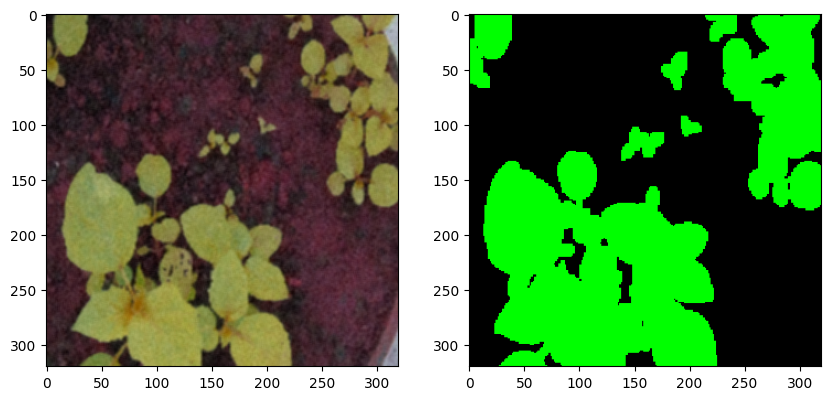

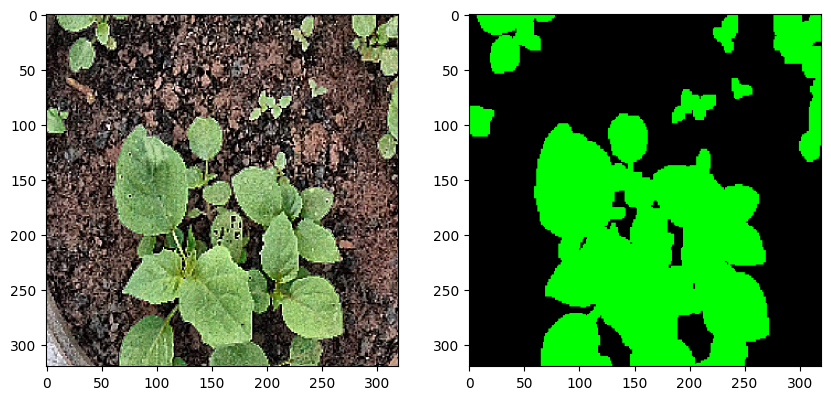

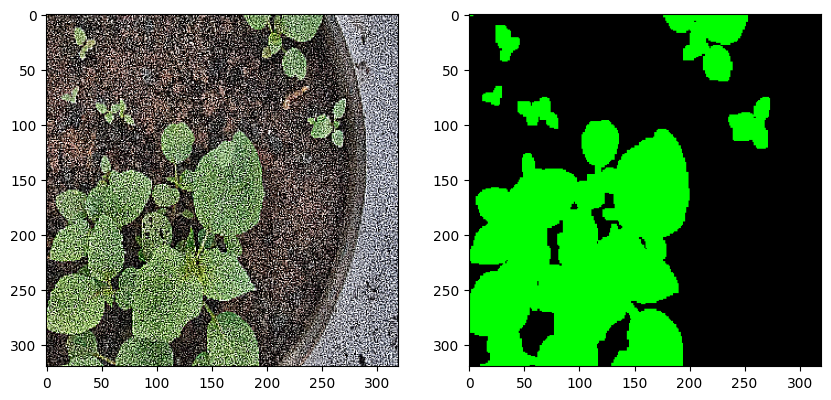

In [11]:
CLASSES = ['weed']

augmented_dataset = Dataset(
    images_path, masks_path,
    x_train, y_train,
    augmentation=get_training_augmentation(),
    classes=CLASSES
)

# same image with different random transforms
for i in range(3):
    image, mask = augmented_dataset[1]
    visualize_im_mask(image, mask)

In [12]:

ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation
DEVICE = 'cuda'

# create segmentation model with pretrained encoder
preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)
train_dataset = Dataset(
    images_path, masks_path,
    x_train, y_train,
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    classes=CLASSES,
)

valid_dataset = Dataset(
    images_path, masks_path,
    x_val, y_val,
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    classes=CLASSES,
)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=12)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=4)


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


# Models creation

- DeepLabV3
- DeepLabV3+
- Unet
- Unet++
- FPN
- PAN
- PSPNET

In [13]:

model_deeplabv3 = smp.DeepLabV3(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)
model_DeepLabV3Plus = smp.DeepLabV3Plus(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION,)
model_Unet = smp.Unet(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)
model_UnetPlusPlus = smp.UnetPlusPlus(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)
model_fpn = smp.FPN(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)
# model_PAN = smp.PAN(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)
# model_PSPNet = smp.PSPNet(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)


Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 140MB/s]


# Training

In [ ]:
def train_model(model, identifier, train_loader, valid_loader):
  learning_rate = 0.0001
  loss = smp.utils.losses.DiceLoss()
  metrics = [smp.utils.metrics.IoU(threshold=0.5)]
  optimizer = torch.optim.Adam([dict(params=model.parameters(), lr=learning_rate)])

  train_epoch = smp.utils.train.TrainEpoch(model, loss=loss, metrics=metrics, optimizer=optimizer, device=DEVICE, verbose=True)
  valid_epoch = smp.utils.train.ValidEpoch(model, loss=loss, metrics=metrics, device=DEVICE, verbose=True)

  max_score = 0
  EPOCHS = 10

  for i in range(0, EPOCHS):
    print('\nEpoch: {}'.format(i))
    train_logs = train_epoch.run(train_loader)
    valid_logs = valid_epoch.run(valid_loader)

    # do something (save model, change lr, etc.)
    if max_score < valid_logs['iou_score']:
      max_score = valid_logs['iou_score']
      torch.save(model, f'drive/My Drive/TCC/best_{identifier}_model.pth')
      print('Model saved!')

    if i % 25 == 0 and index != 0:
      learning_rate = learning_rate / 10
      optimizer.param_groups[0]['lr'] = learning_rate
      print(f'Decrease decoder learning rate to {learning_rate}!')

  return train_logs, val_logs

deeplabv3plus_train_logs, deeplabv3plus_val_logs = train_model(model_DeepLabV3Plus, 'DeepLabV3Plus', train_loader, valid_loader)
deeplabv3_train_logs, deeplabv3_val_logs = train_model(model_deeplabv3, 'DeepLabV3', train_loader, valid_loader)
unet_train_logs, unet_val_logs = train_model(model_Unet, 'Unet', train_loader, valid_loader)
unetplus_train_logs, unetplus_val_logs = train_model(model_UnetPlusPlus, 'UnetPlusPlus', train_loader, valid_loader)
fpn_train_logs, fpn_val_logs = train_model(model_fpn, 'fpn', train_loader, valid_loader)


Epoch: 0
valid: 100%|██████████| 113/113 [00:49<00:00,  2.28it/s, dice_loss - 0.3716, iou_score - 0.5749]
Model saved!
Decrease decoder learning rate to 1e-05!

Epoch: 1
valid: 100%|██████████| 113/113 [00:50<00:00,  2.23it/s, dice_loss - 0.3449, iou_score - 0.6043]
Model saved!

Epoch: 2
valid: 100%|██████████| 113/113 [00:49<00:00,  2.30it/s, dice_loss - 0.3313, iou_score - 0.625]
Model saved!

Epoch: 3
valid: 100%|██████████| 113/113 [00:50<00:00,  2.22it/s, dice_loss - 0.3172, iou_score - 0.6592]
Model saved!

Epoch: 4
valid: 100%|██████████| 113/113 [00:50<00:00,  2.24it/s, dice_loss - 0.3064, iou_score - 0.6793]
Model saved!

Epoch: 5
valid: 100%|██████████| 113/113 [00:51<00:00,  2.19it/s, dice_loss - 0.2922, iou_score - 0.6967]
Model saved!

Epoch: 6
valid: 100%|██████████| 113/113 [00:49<00:00,  2.30it/s, dice_loss - 0.2847, iou_score - 0.7192]
Model saved!

Epoch: 7
valid: 100%|██████████| 113/113 [00:51<00:00,  2.21it/s, dice_loss - 0.2743, iou_score - 0.7322]
Model saved!


error: ignored

In [ ]:
x_train_families = {'Convolvulaceae': [], 'Poaceae': [], 'Apiaceae': [], 'Asteraceae': [], 'Amaranthaceae': [], 'Brassicaceae': [], 'Solanaceae': [], 'Lamiaceae': []}
y_train_families = {'Convolvulaceae': [], 'Poaceae': [], 'Apiaceae': [], 'Asteraceae': [], 'Amaranthaceae': [], 'Brassicaceae': [], 'Solanaceae': [], 'Lamiaceae': []}

for filename in x_test:
  for family in x_train_families:
    if family in filename:
      x_train_families[family].append(filename)
      y_train_families[family].append(filename)

print(f'convolvulaceae test size {len(x_train_families["Convolvulaceae"])}')
print(f'poaceae test size {len(x_train_families["Poaceae"])}')
print(f'apiaceae test size {len(x_train_families["Apiaceae"])}')
print(f'asteraceae test size {len(x_train_families["Asteraceae"])}')
print(f'amaranthaceae test size {len(x_train_families["Amaranthaceae"])}')
print(f'brassicaceae test size {len(x_train_families["Brassicaceae"])}')
print(f'solanaceae test size {len(x_train_families["Solanaceae"])}')
print(f'lamiaceae test size {len(x_train_families["Lamiaceae"])}')

# Evaluation

In [60]:
MODEL_PATH = "drive/My Drive/TCC/segmentation_models"

# best_deeplabv3plus_model = torch.load(MODEL_PATH + '/best_DeepLabV3Plus_model.pth')
# best_deeplabv3_model = torch.load(MODEL_PATH + '/best_DeepLabV3Plus_model.pth')
# best_unet_model = torch.load(MODEL_PATH + '/best_Unet_model.pth')
# best_unetpp_model = torch.load(MODEL_PATH + '/best_UnetPlusPlus_model.pth')
# best_fpn_model = torch.load(MODEL_PATH + '/best_fpn_model.pth')

best_models = [
  torch.load(MODEL_PATH + '/best_DeepLabV3Plus_model.pth'),
  torch.load(MODEL_PATH + '/best_DeepLabV3_model.pth'),
  torch.load(MODEL_PATH + '/best_Unet_model.pth'),
  torch.load(MODEL_PATH + '/best_UnetPlusPlus_model.pth'),
  torch.load(MODEL_PATH + '/best_fpn_model.pth')
]

def create_test_datasets():
  x_train_families = {'Convolvulaceae': [], 'Poaceae': [], 'Apiaceae': [], 'Asteraceae': [], 'Amaranthaceae': [], 'Brassicaceae': [], 'Solanaceae': [], 'Lamiaceae': []}
  y_train_families = {'Convolvulaceae': [], 'Poaceae': [], 'Apiaceae': [], 'Asteraceae': [], 'Amaranthaceae': [], 'Brassicaceae': [], 'Solanaceae': [], 'Lamiaceae': []}

  for filename in x_test:
    for family in x_train_families:
      if family in filename:
        x_train_families[family].append(filename)
        y_train_families[family].append(filename.replace('JPG', 'png'))

  test_datasets = []
  for family in x_train_families:
    dataset = Dataset(
      images_path, masks_path,
      x_train_families[family], y_train_families[family],
      augmentation=get_validation_augmentation(),
      preprocessing=get_preprocessing(preprocessing_fn),
      classes=CLASSES,
    )

    test_datasets.append(dataset)

  return test_datasets


def extract_metrics(model):
  loss = smp.utils.losses.DiceLoss()
  metrics = [
      smp.utils.metrics.IoU(threshold=0.5),
      smp.utils.metrics.Fscore(threshold=0.5),
      smp.utils.metrics.Accuracy(threshold=0.5),
      smp.utils.metrics.Recall(threshold=0.5),
      smp.utils.metrics.Precision(threshold=0.5)
  ]

  # create test dataset
  all_logs = []
  test_datasets = create_test_datasets()
  families = ['Convolvulaceae', 'Poaceae', 'Apiaceae', 'Asteraceae', 'Amaranthaceae', 'Brassicaceae', 'Solanaceae', 'Lamiaceae']
  for index, test_dataset in enumerate(test_datasets):
    test_dataloader = DataLoader(test_dataset)

    # evaluate model on test set
    test_epoch = smp.utils.train.ValidEpoch(
        model=model,
        loss=loss,
        metrics=metrics,
        device=DEVICE,
    )

    print(families[index])
    logs = test_epoch.run(test_dataloader)
    all_logs.append(logs)
  return all_logs

for model in best_models:
  print(model._get_name())
  extract_metrics(model)


DeepLabV3Plus
Convolvulaceae
valid: 100%|██████████| 9/9 [00:04<00:00,  2.15it/s, dice_loss - 0.1984, iou_score - 0.8323, fscore - 0.9078, accuracy - 0.9662, recall - 0.9141, precision - 0.9026]
Poaceae
valid: 100%|██████████| 37/37 [00:18<00:00,  1.97it/s, dice_loss - 0.4011, iou_score - 0.6306, fscore - 0.7579, accuracy - 0.9358, recall - 0.7482, precision - 0.8253]
Apiaceae
valid: 100%|██████████| 6/6 [00:04<00:00,  1.50it/s, dice_loss - 0.4086, iou_score - 0.5562, fscore - 0.7037, accuracy - 0.9519, recall - 0.6976, precision - 0.746]
Asteraceae
valid: 100%|██████████| 31/31 [00:16<00:00,  1.91it/s, dice_loss - 0.2595, iou_score - 0.7862, fscore - 0.8733, accuracy - 0.967, recall - 0.9082, precision - 0.8474]
Amaranthaceae
valid: 100%|██████████| 11/11 [00:05<00:00,  2.11it/s, dice_loss - 0.1975, iou_score - 0.7758, fscore - 0.8496, accuracy - 0.9466, recall - 0.8826, precision - 0.871]
Brassicaceae
valid: 100%|██████████| 7/7 [00:03<00:00,  2.17it/s, dice_loss - 0.539, iou_score -

# Visualize predictons

In [ ]:
# test dataset without transformations for image visualization

def create_test_datasets_vis():
  x_train_families = {'Convolvulaceae': [], 'Poaceae': [], 'Apiaceae': [], 'Asteraceae': [], 'Amaranthaceae': [], 'Brassicaceae': [], 'Solanaceae': [], 'Lamiaceae': []}
  y_train_families = {'Convolvulaceae': [], 'Poaceae': [], 'Apiaceae': [], 'Asteraceae': [], 'Amaranthaceae': [], 'Brassicaceae': [], 'Solanaceae': [], 'Lamiaceae': []}

  for filename in x_test:
    for family in x_train_families:
      if family in filename:
        x_train_families[family].append(filename)
        y_train_families[family].append(filename.replace('JPG', 'png'))

  test_datasets = []
  for family in x_train_families:
    dataset = Dataset(
      images_path, masks_path,
      x_train_families[family], y_train_families[family],
      preprocessing=get_preprocessing(preprocessing_fn),
      classes=CLASSES,
    )

    test_datasets.append(dataset)

  return test_datasets

test_datasets_vis = create_test_datasets_vis()

######################################
####### DeepLabV3Plus ########
######################################
########## Convolvulaceae ############


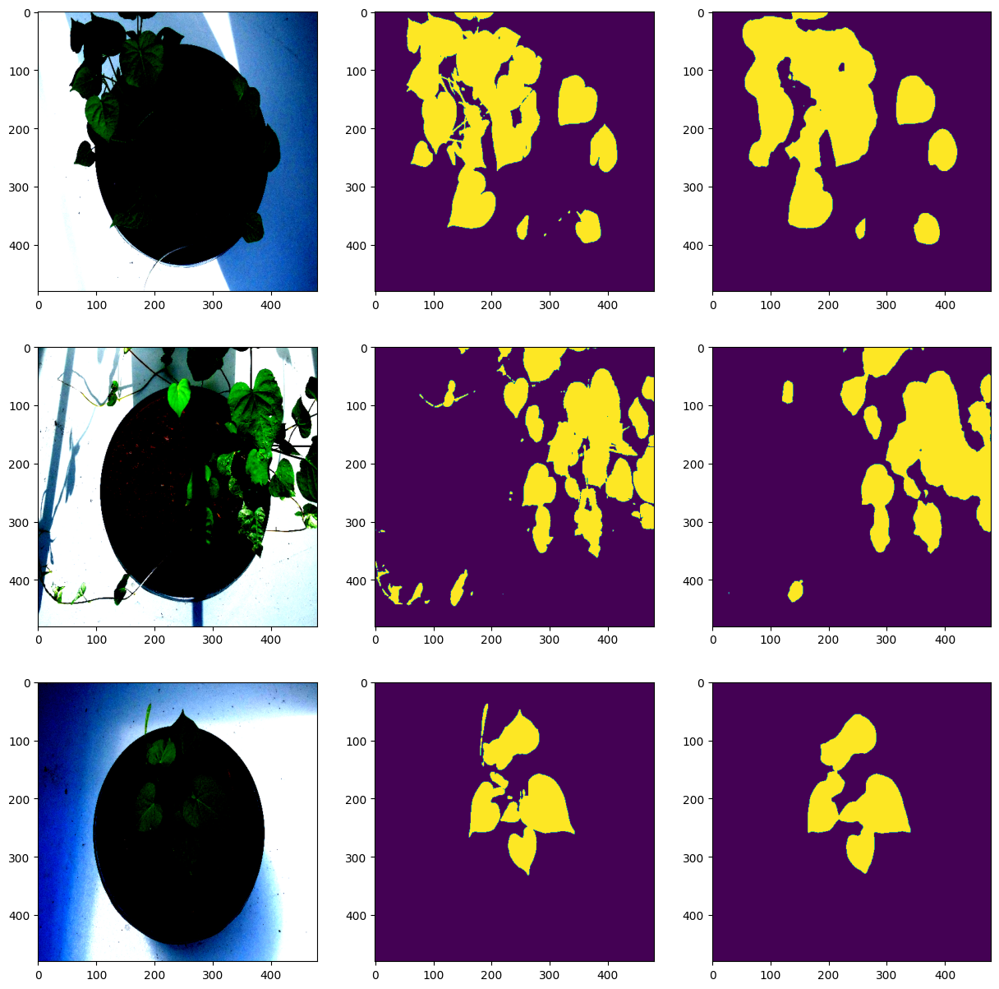

########## Poaceae ############


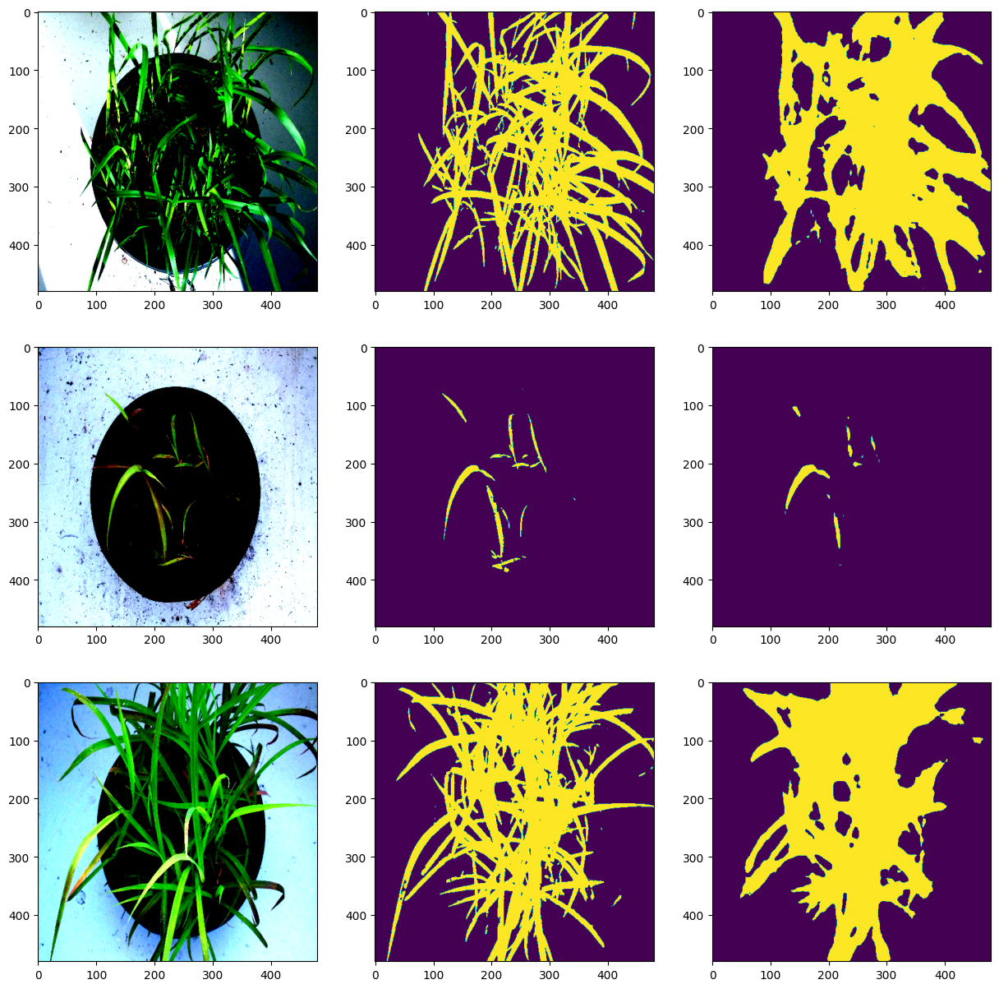

########## Apiaceae ############


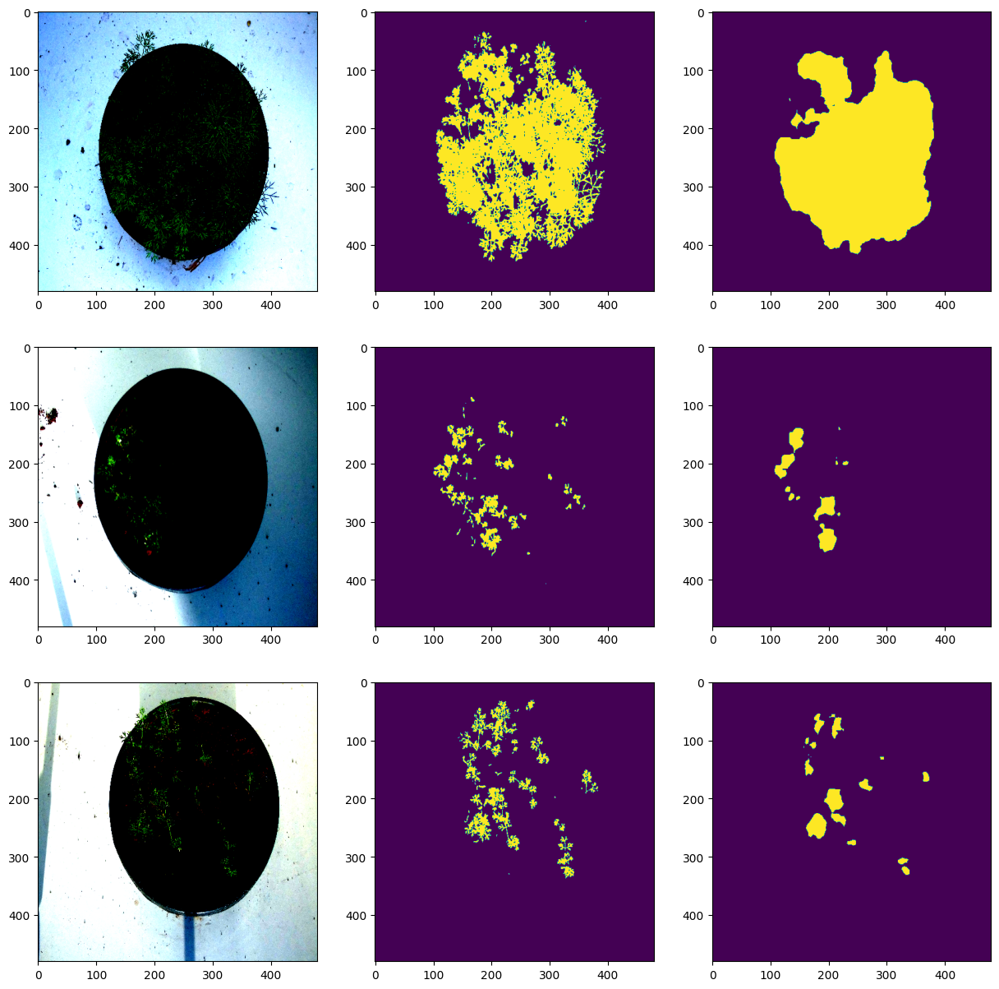

########## Asteraceae ############


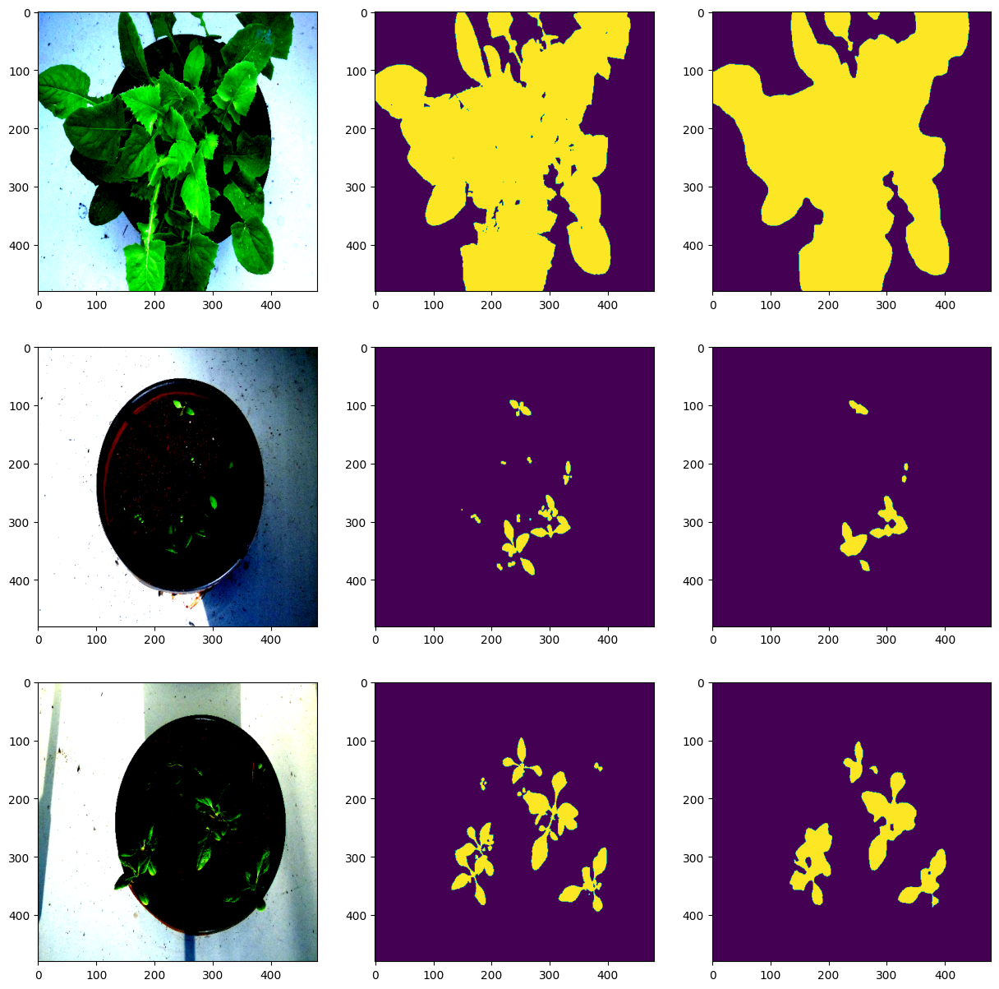

########## Amaranthaceae ############


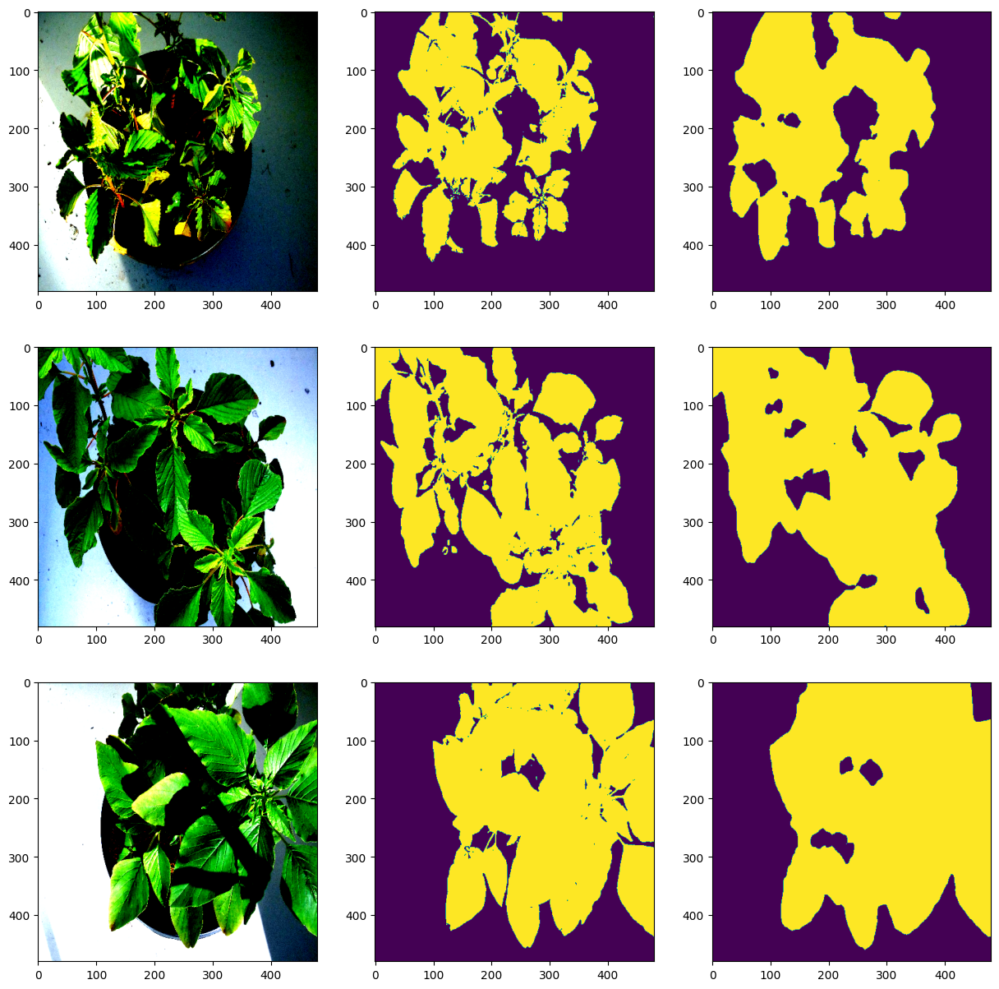

########## Brassicaceae ############


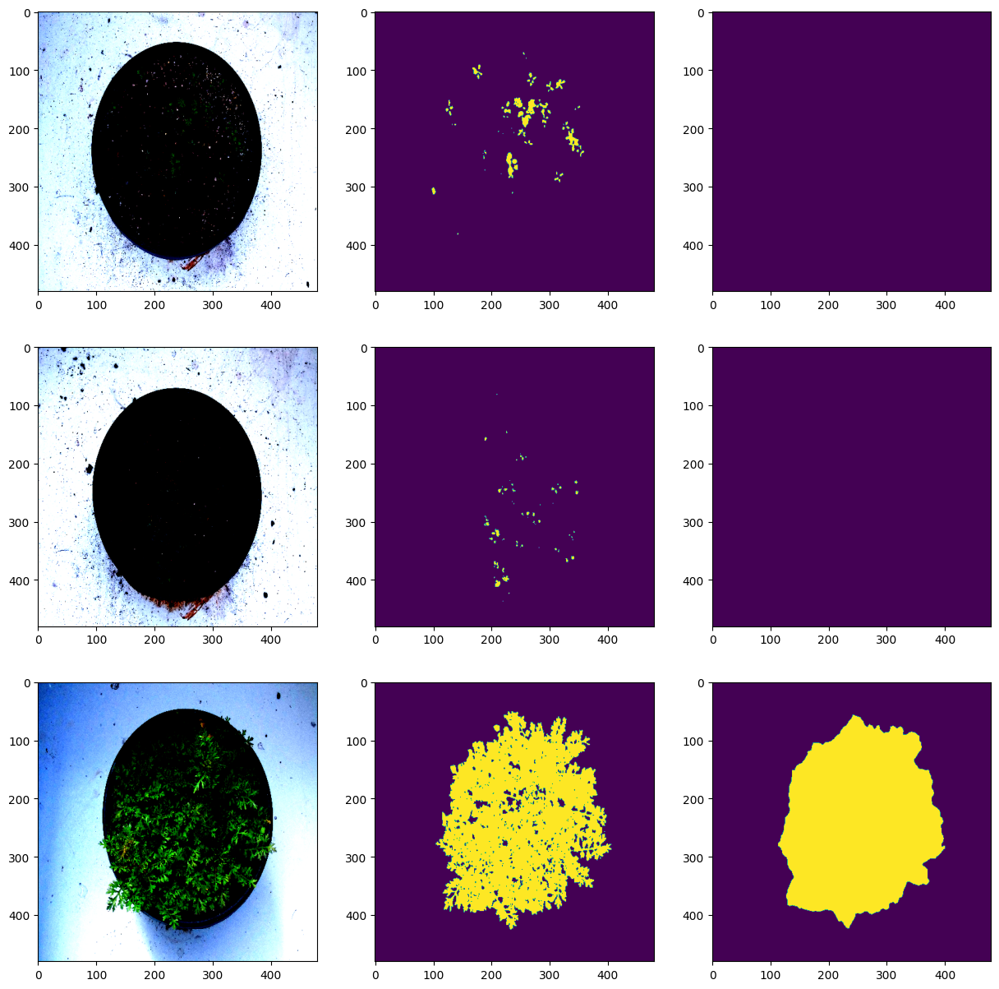

########## Solanaceae ############


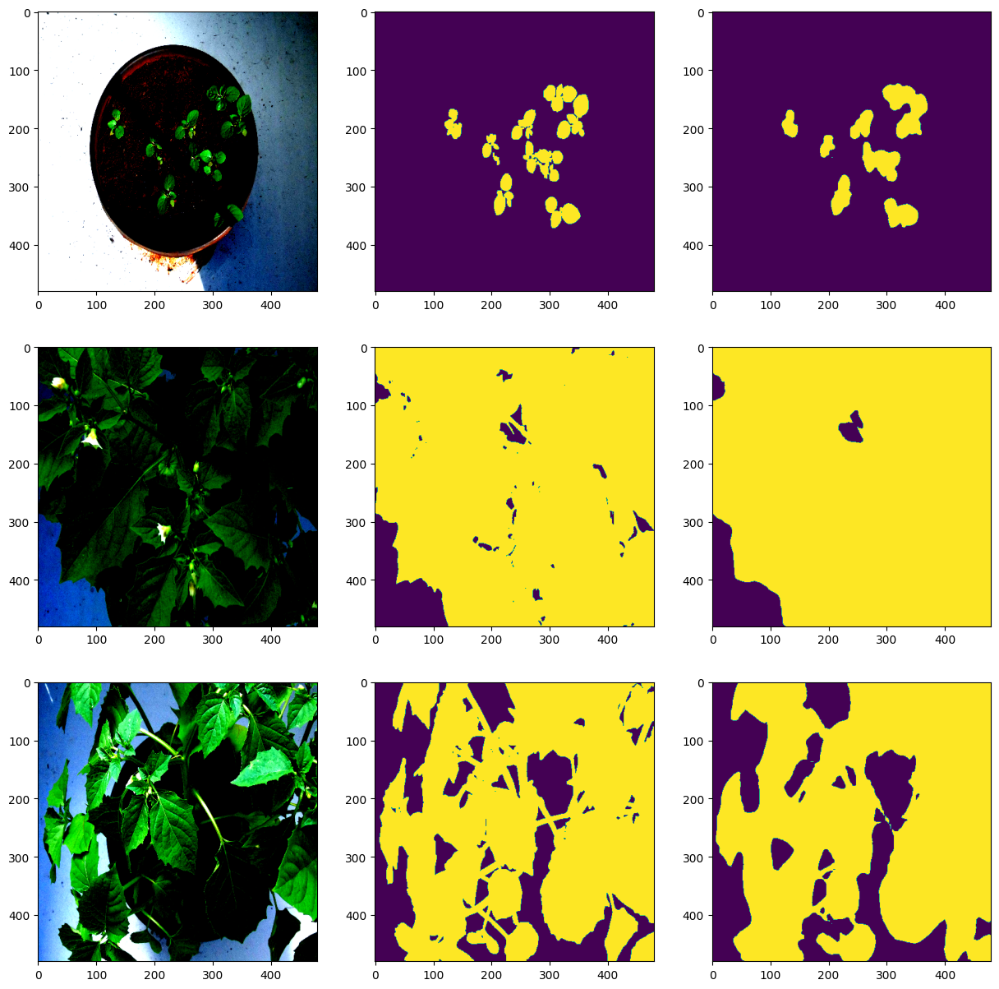

########## Lamiaceae ############


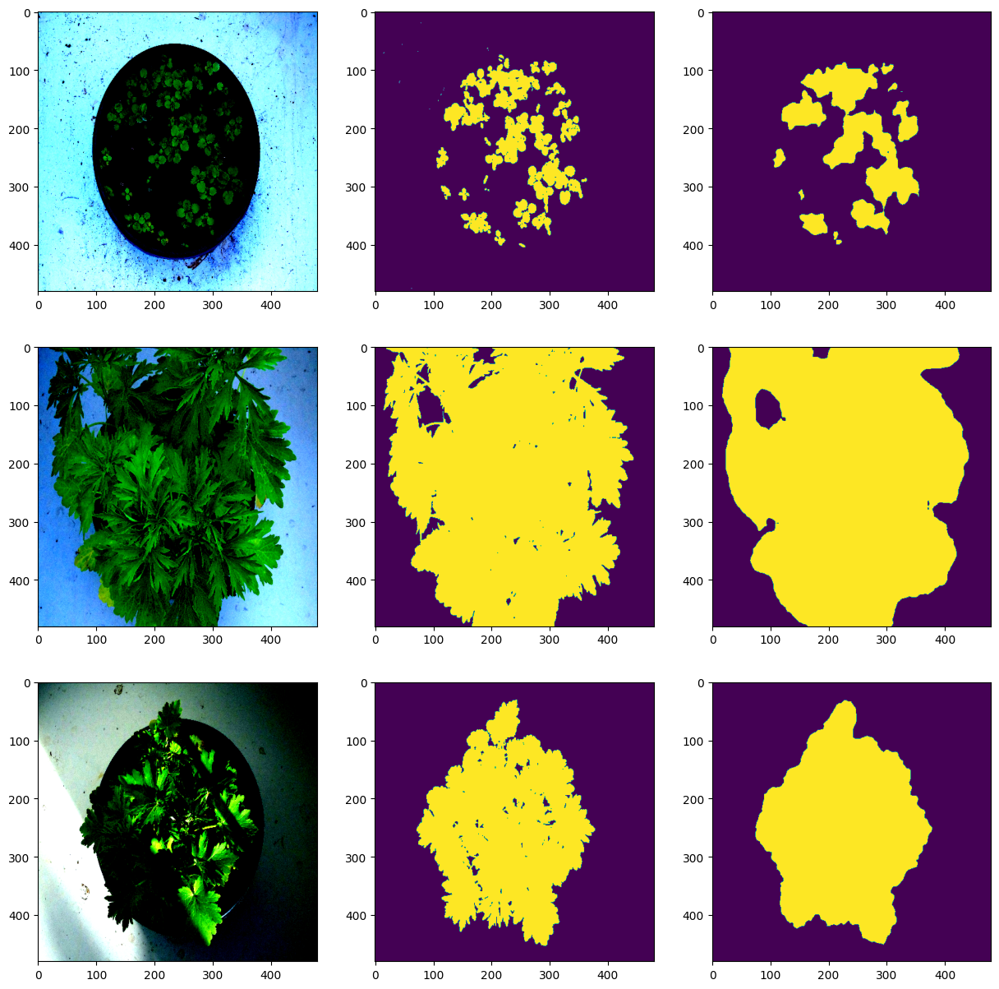

######################################
####### DeepLabV3 ########
######################################
########## Convolvulaceae ############


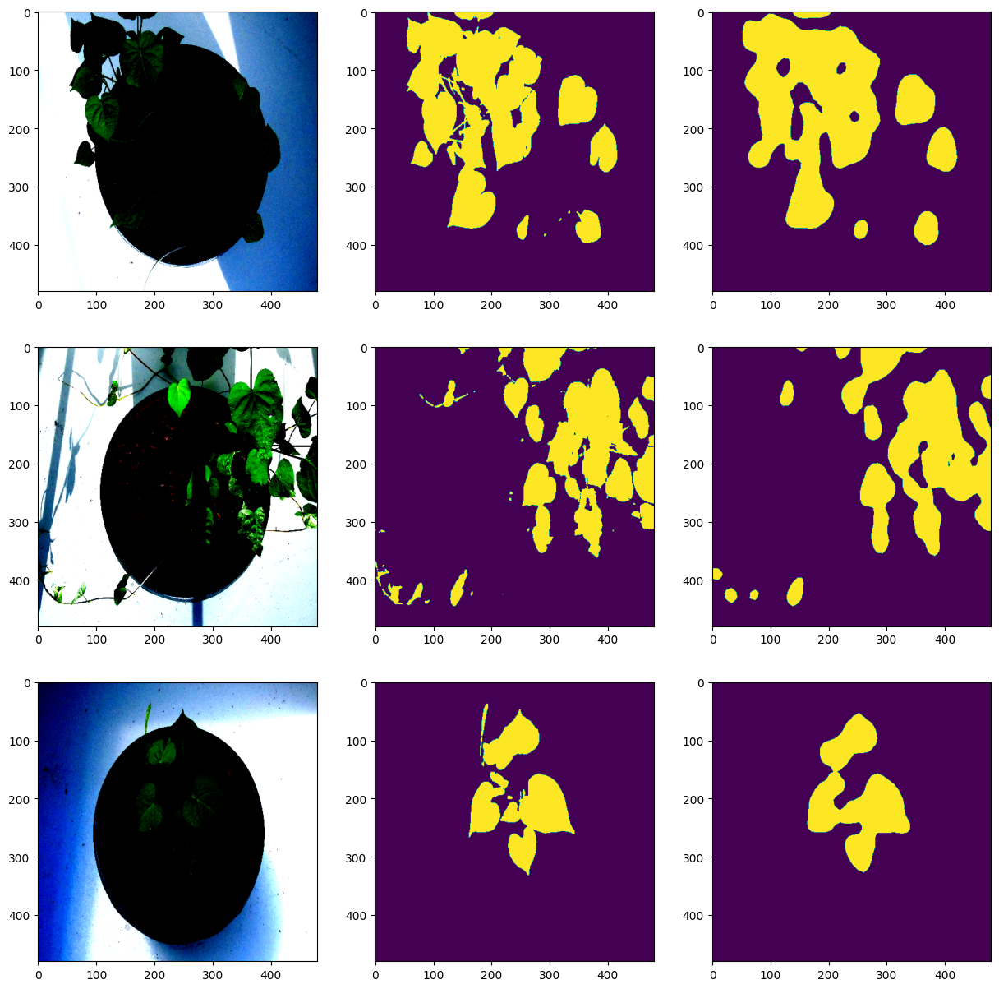

########## Poaceae ############


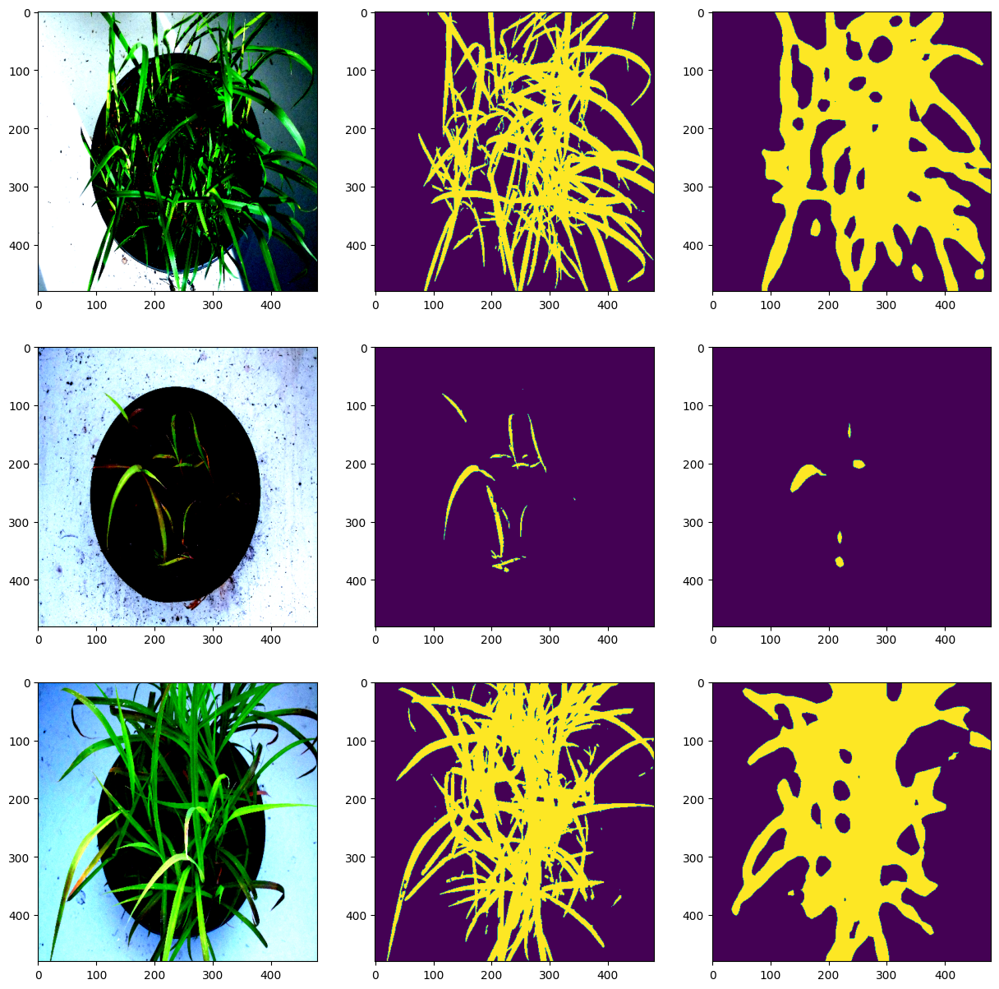

########## Apiaceae ############


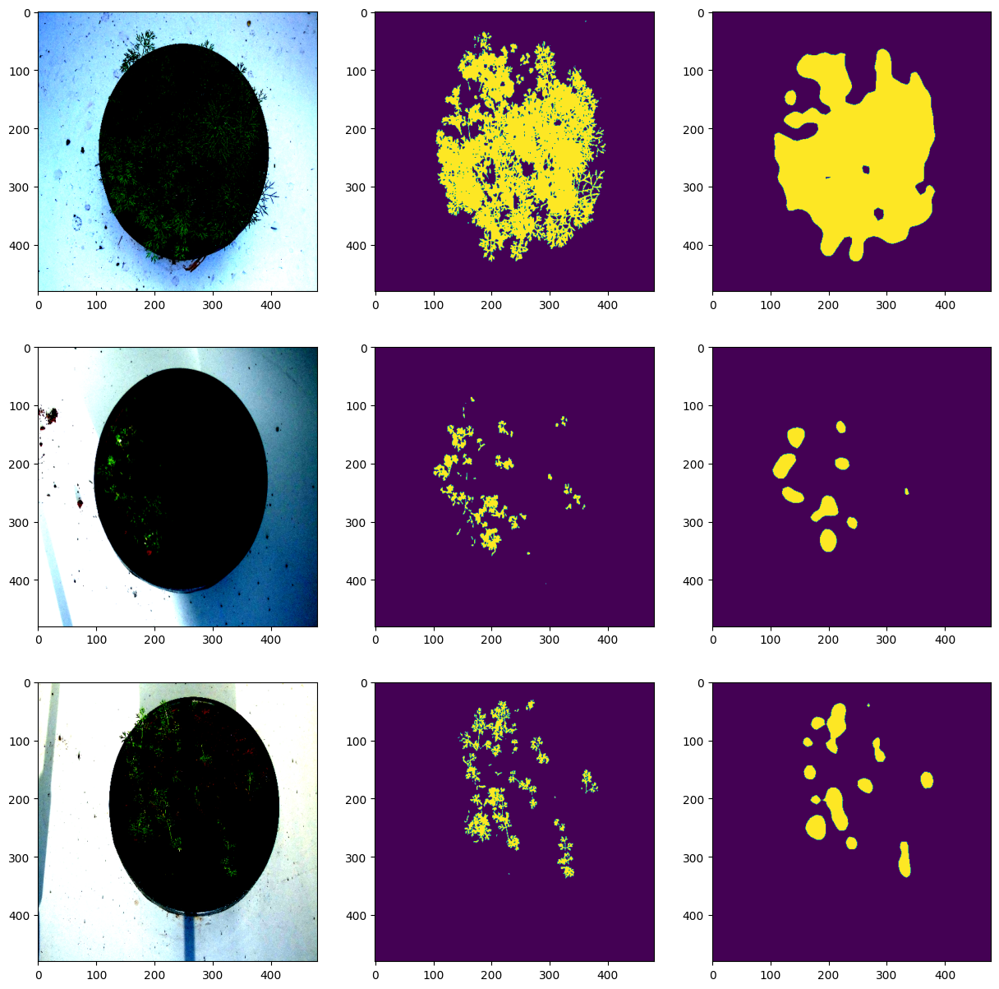

########## Asteraceae ############


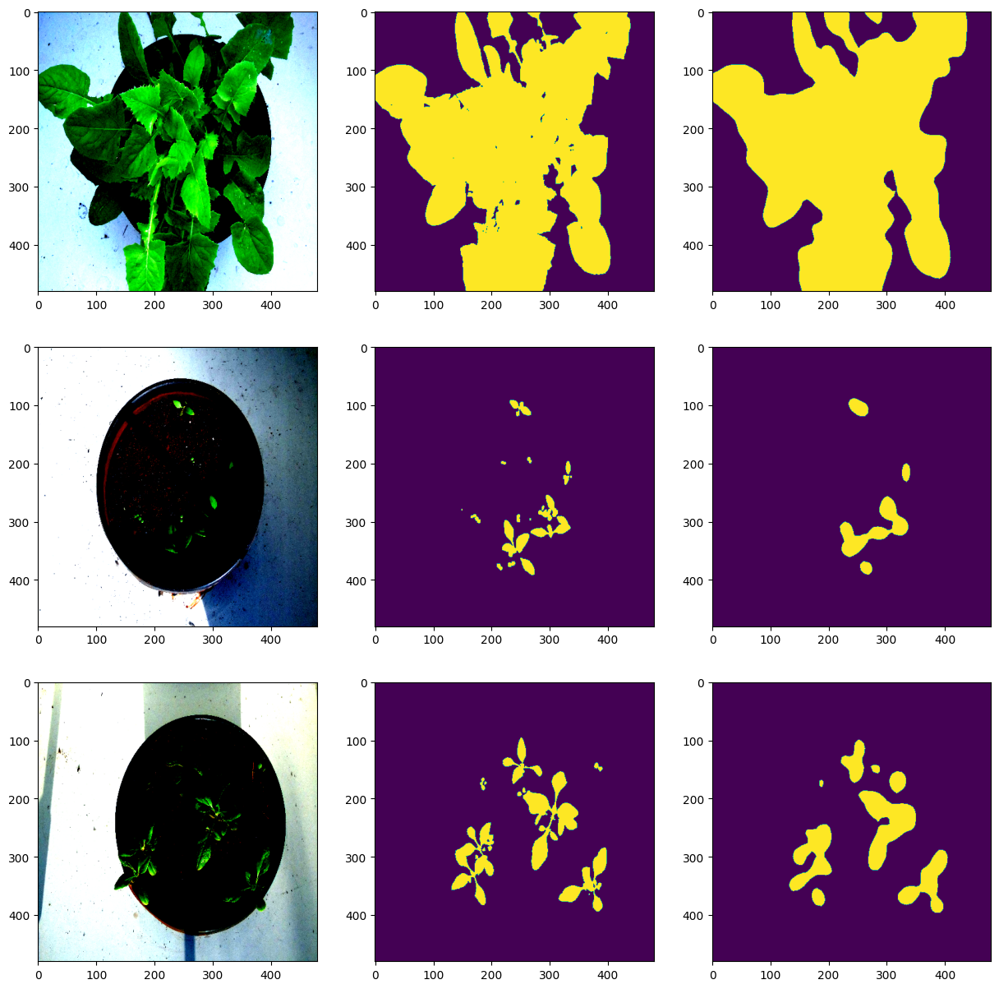

########## Amaranthaceae ############


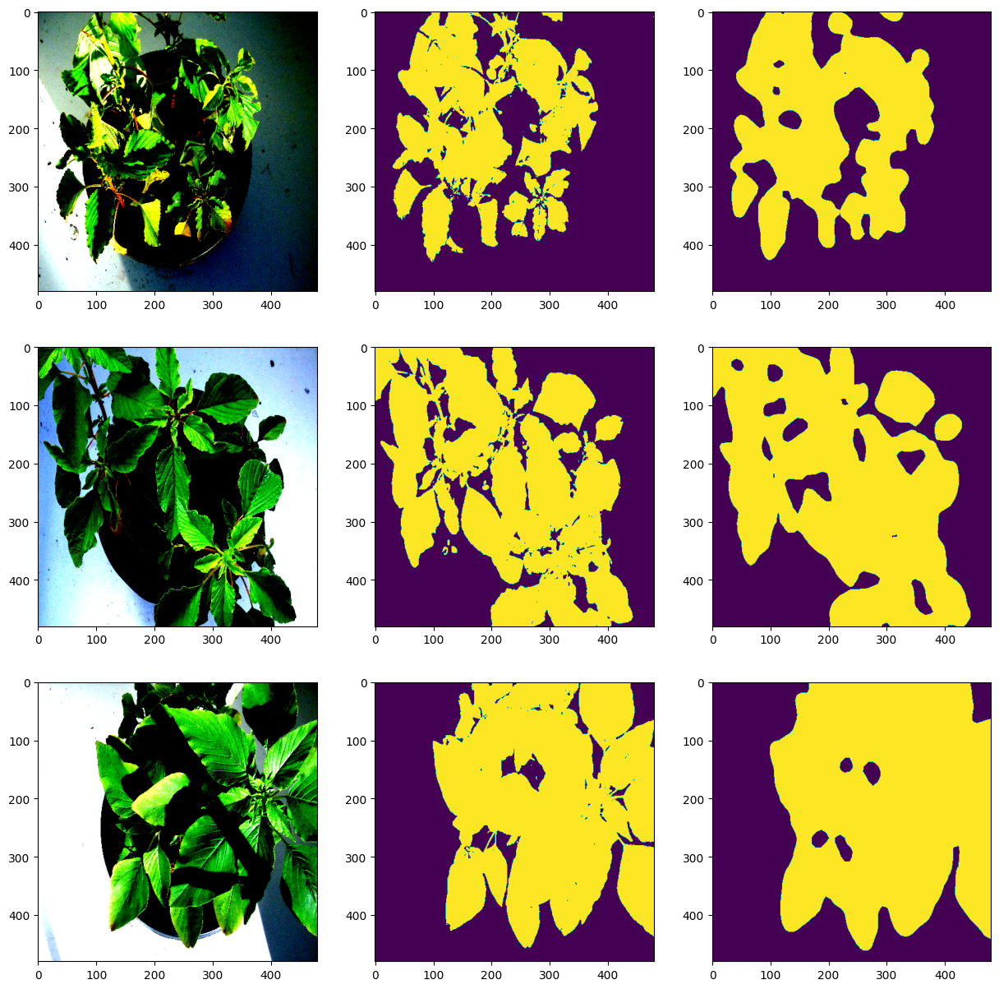

########## Brassicaceae ############


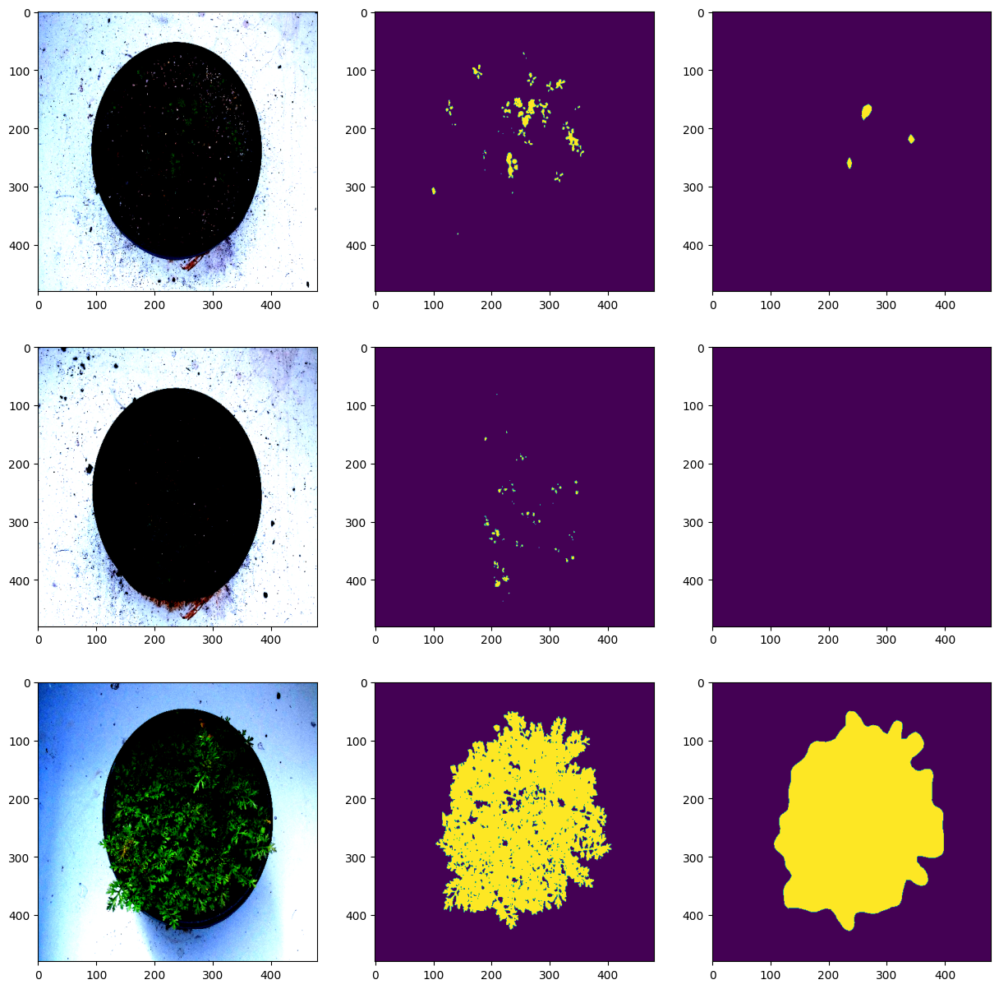

########## Solanaceae ############


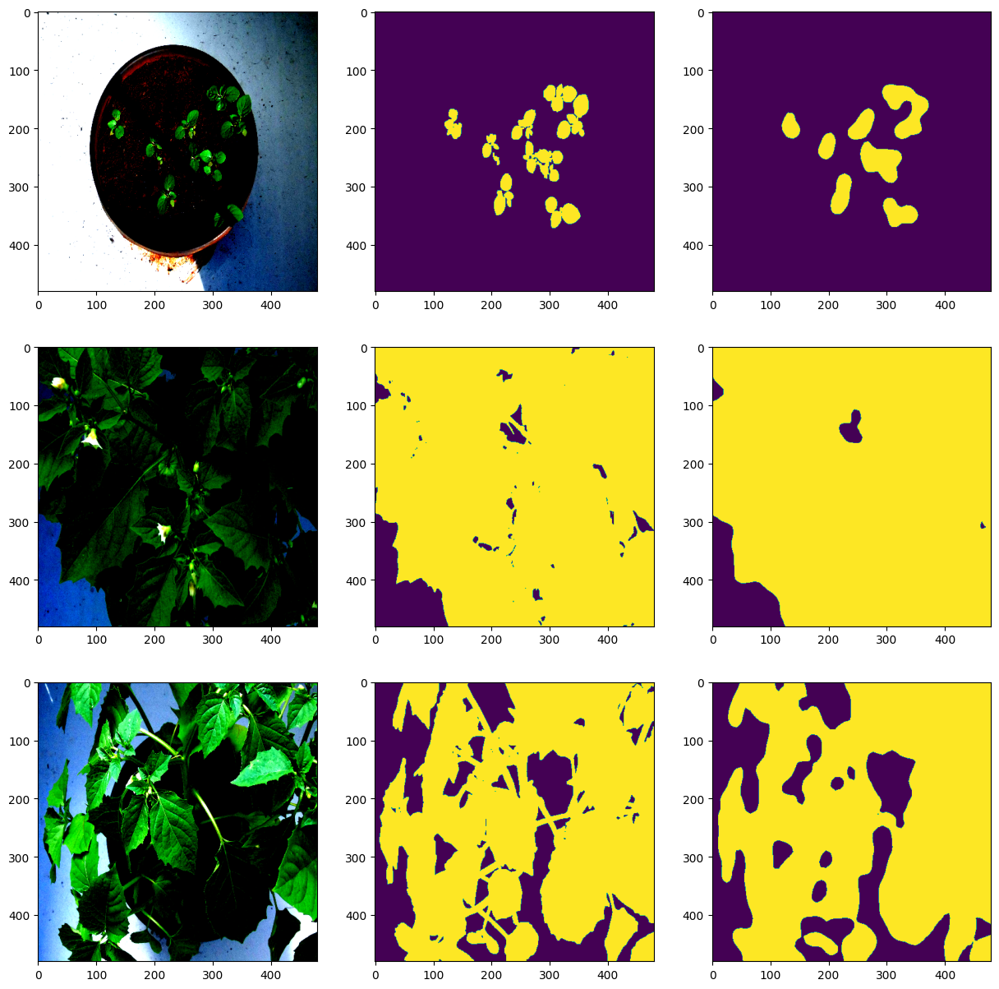

########## Lamiaceae ############


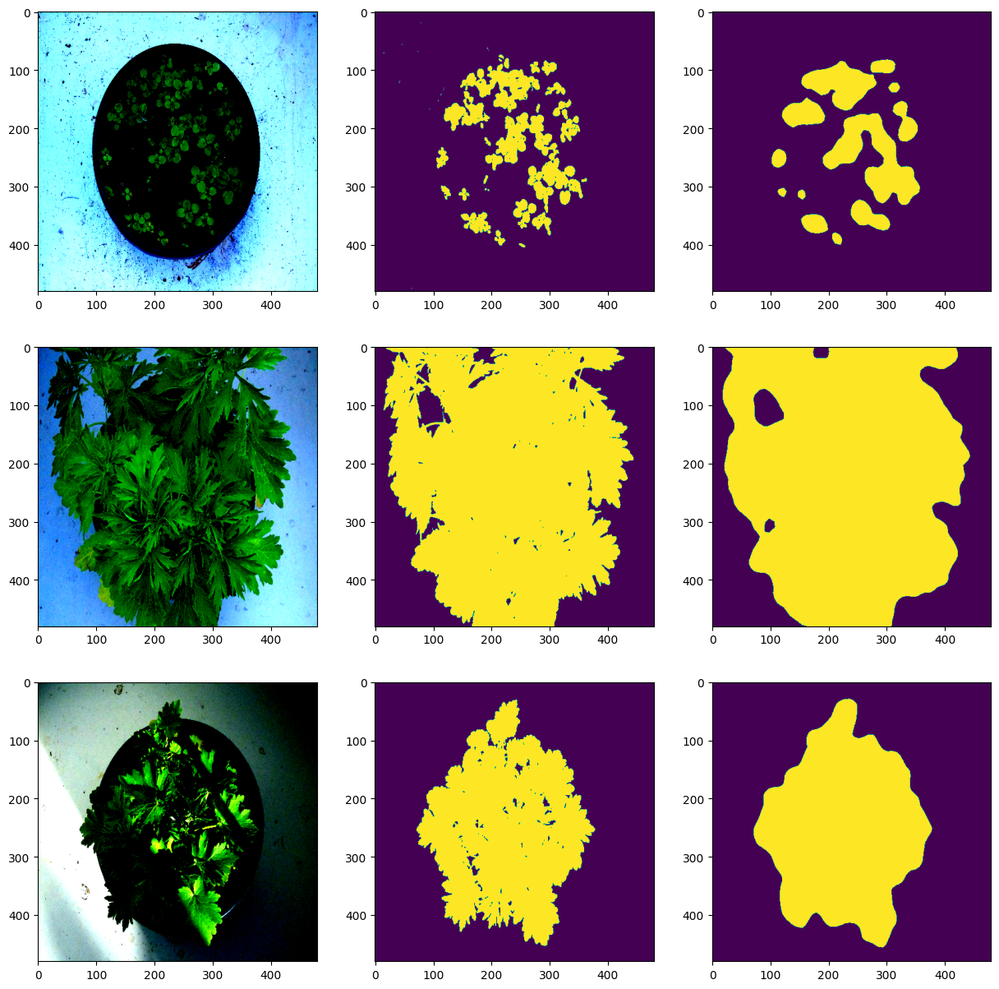

######################################
####### Unet ########
######################################
########## Convolvulaceae ############


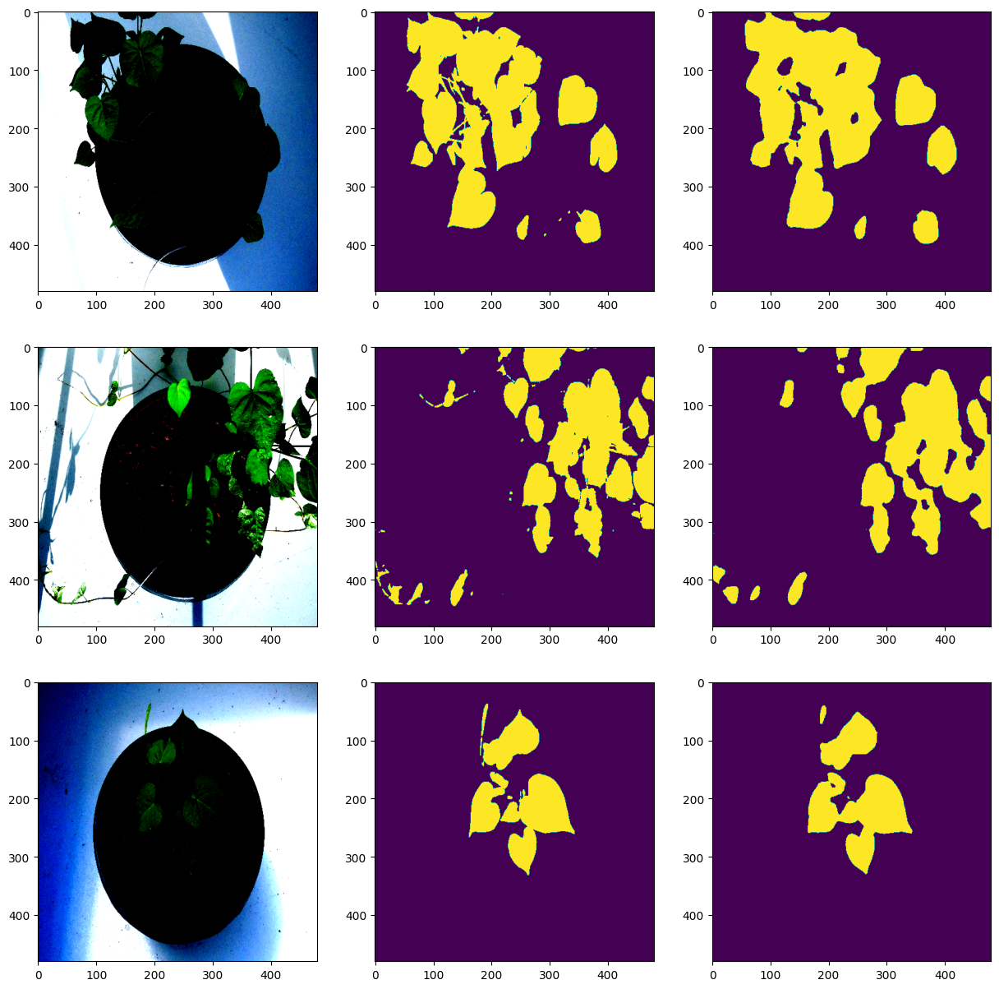

########## Poaceae ############


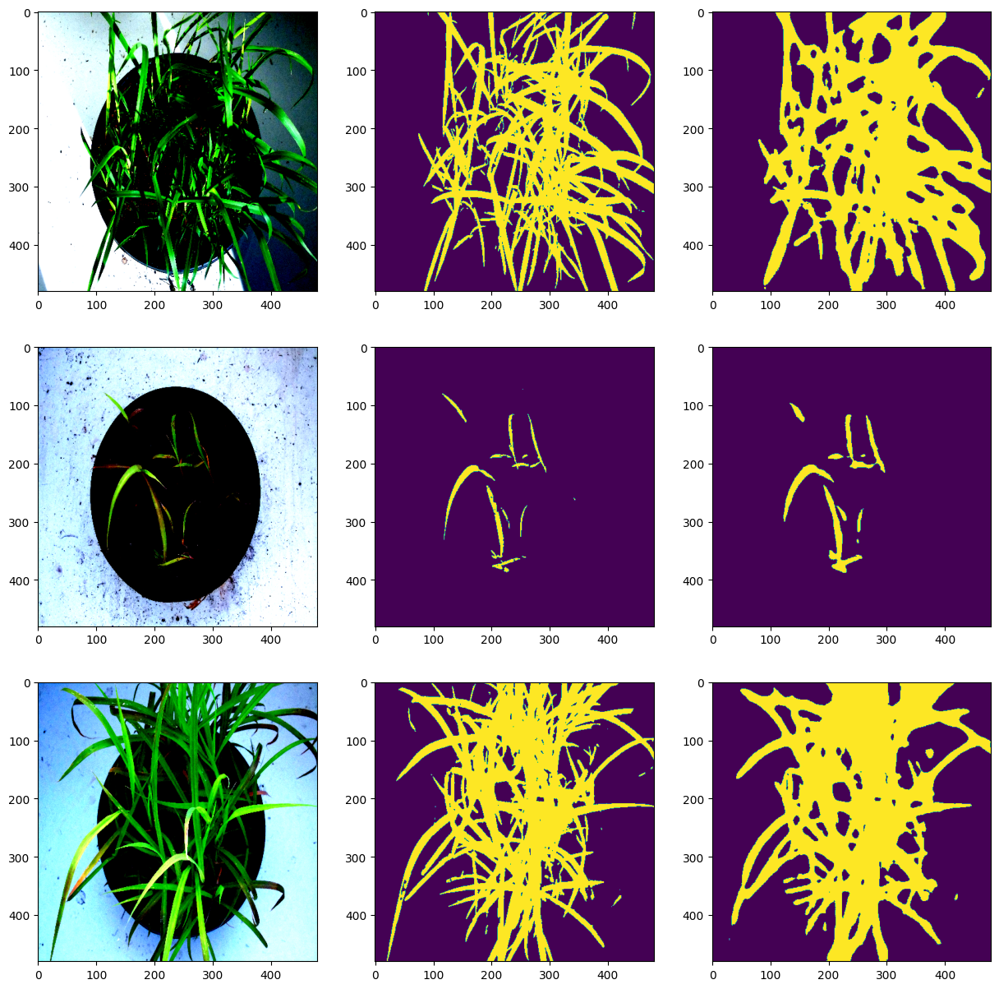

########## Apiaceae ############


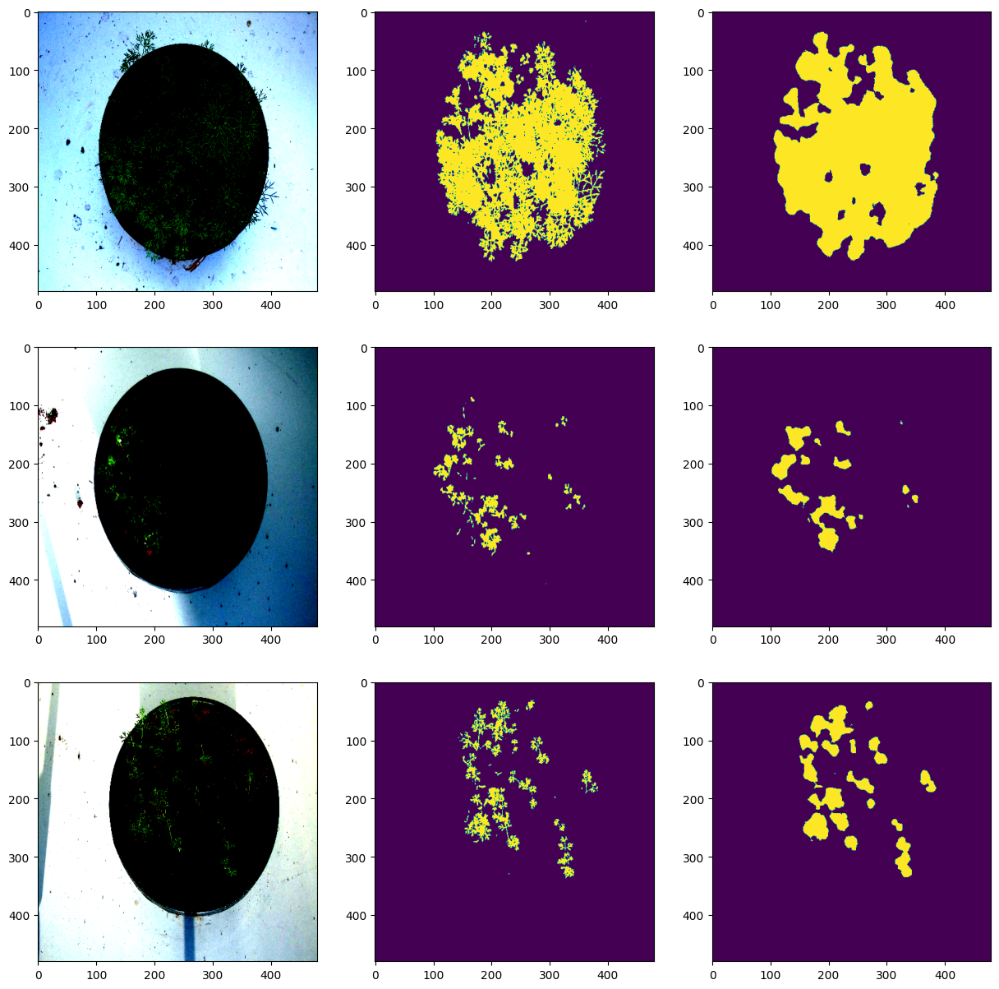

########## Asteraceae ############


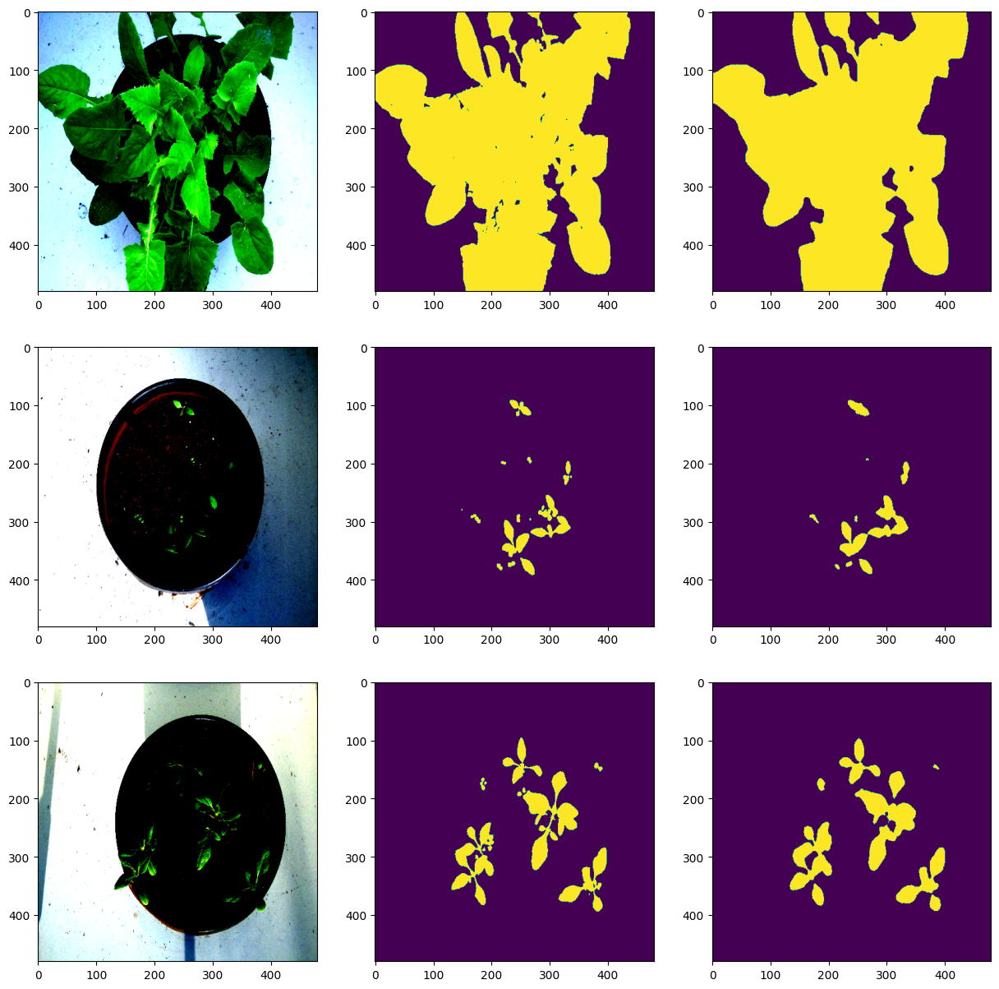

########## Amaranthaceae ############


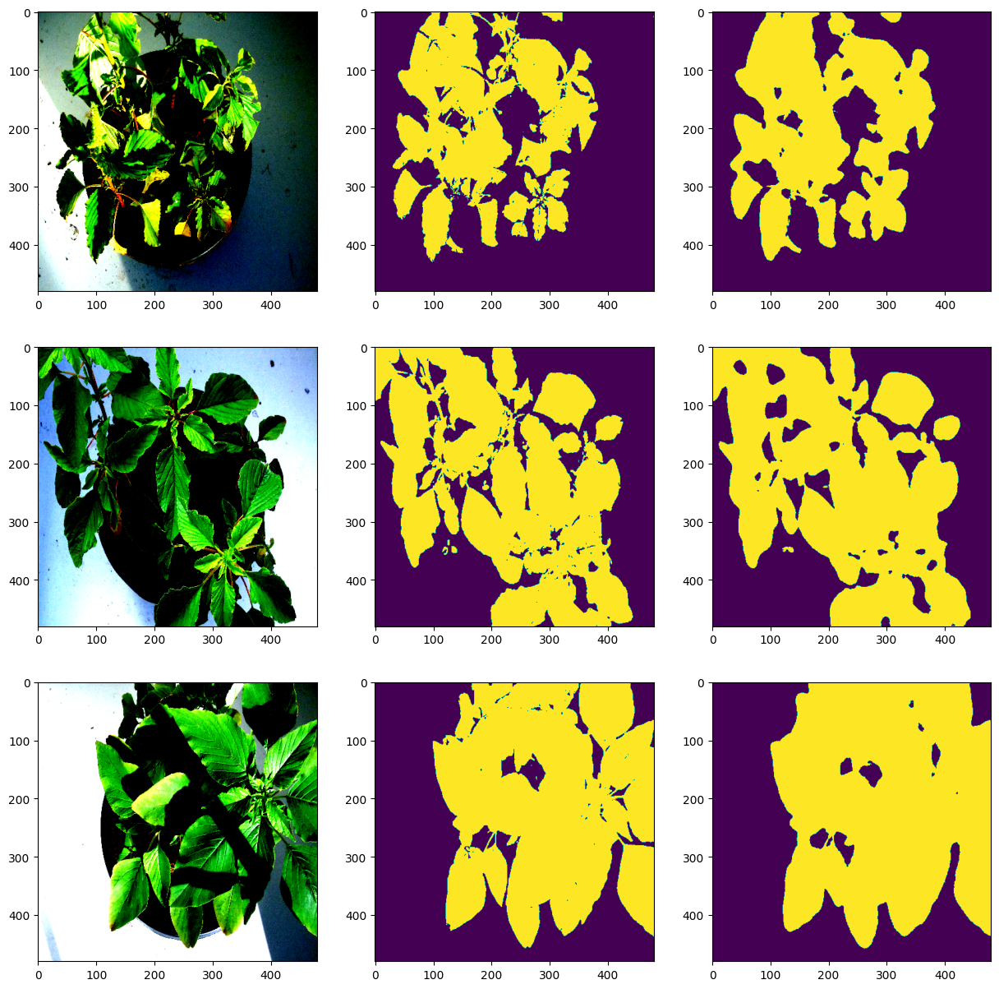

########## Brassicaceae ############


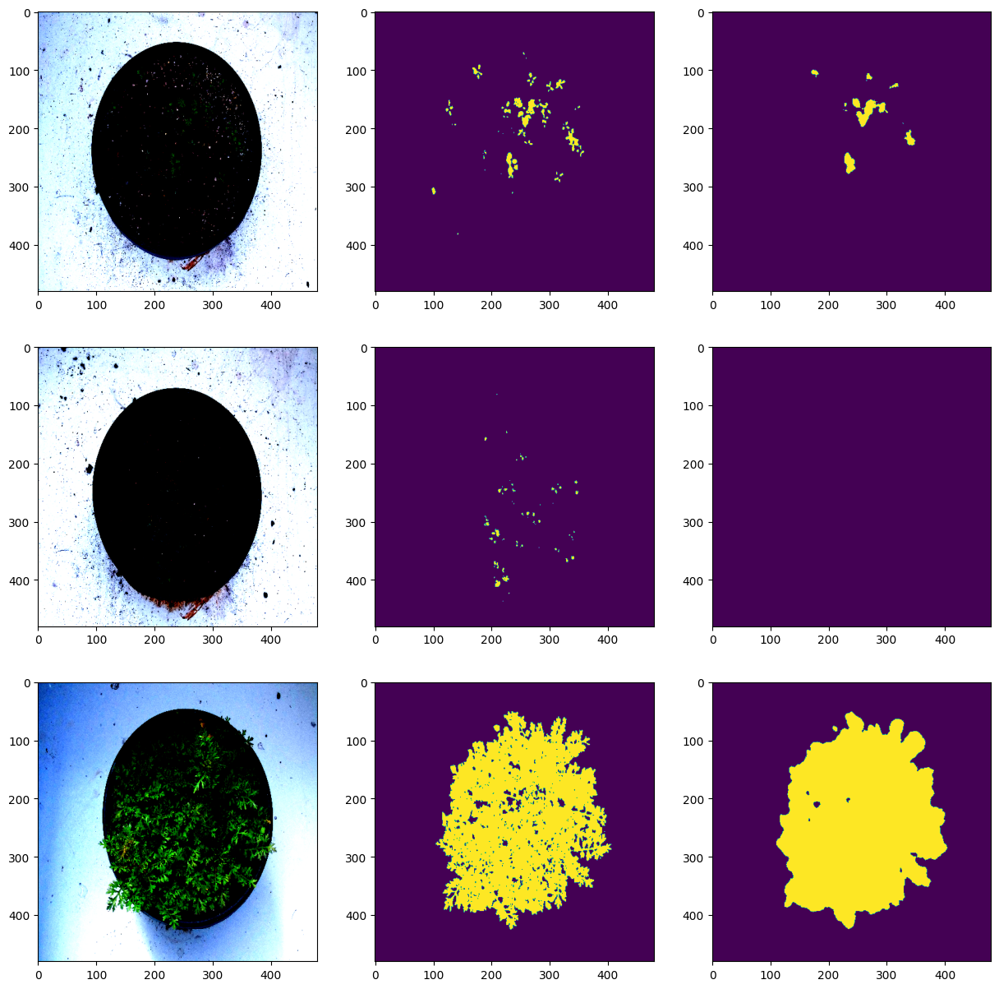

########## Solanaceae ############


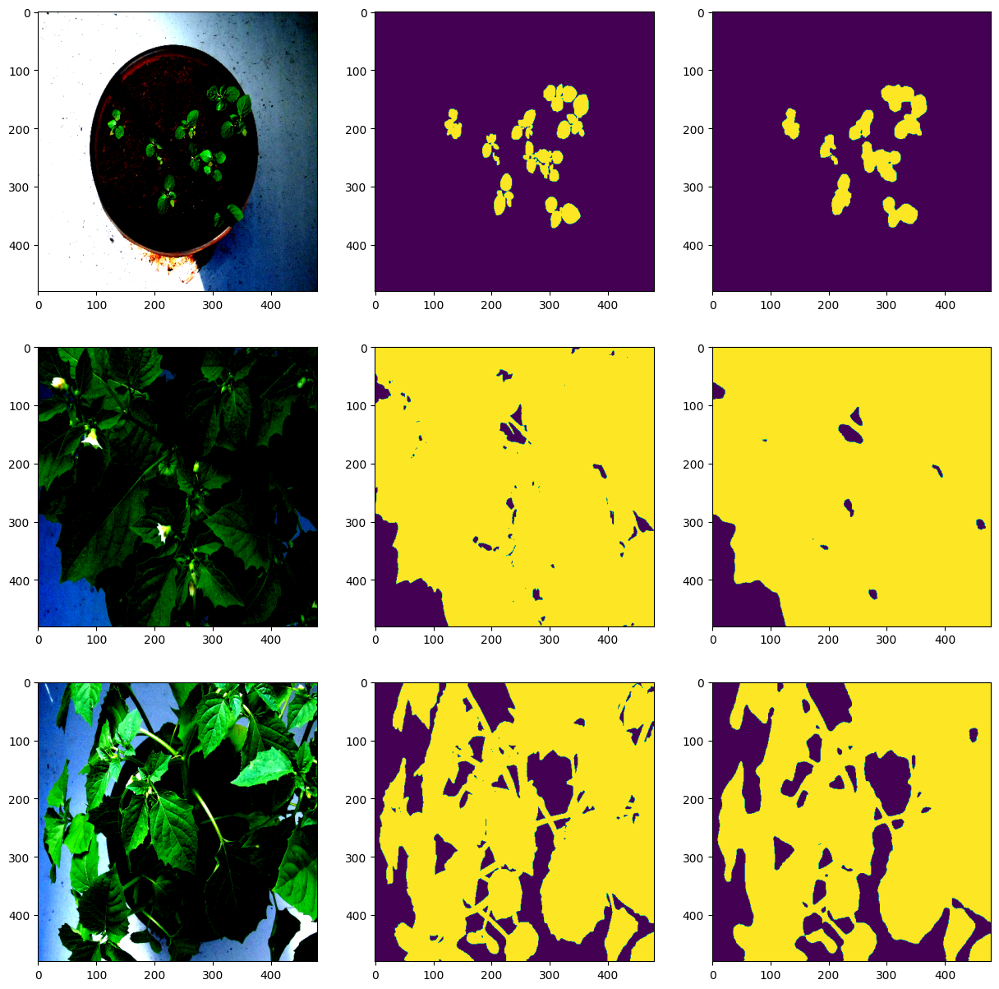

########## Lamiaceae ############


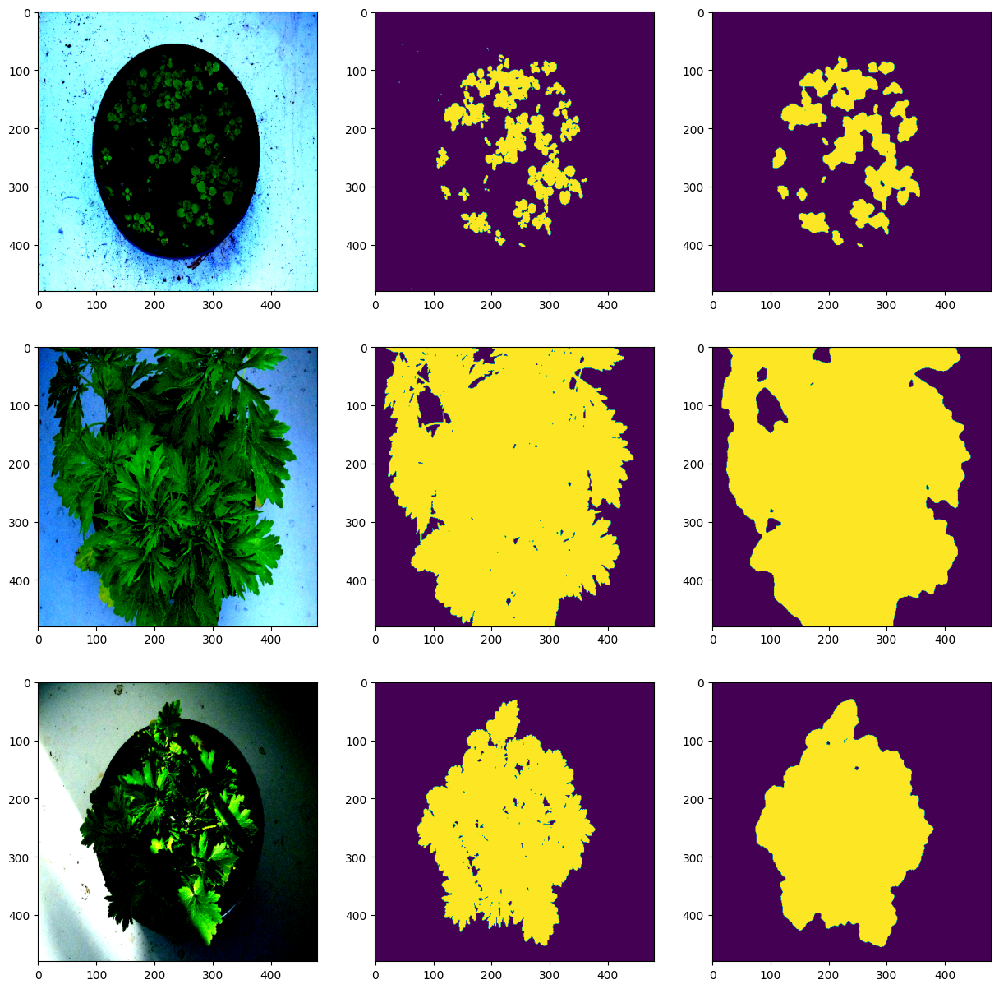

######################################
####### UnetPlusPlus ########
######################################
########## Convolvulaceae ############


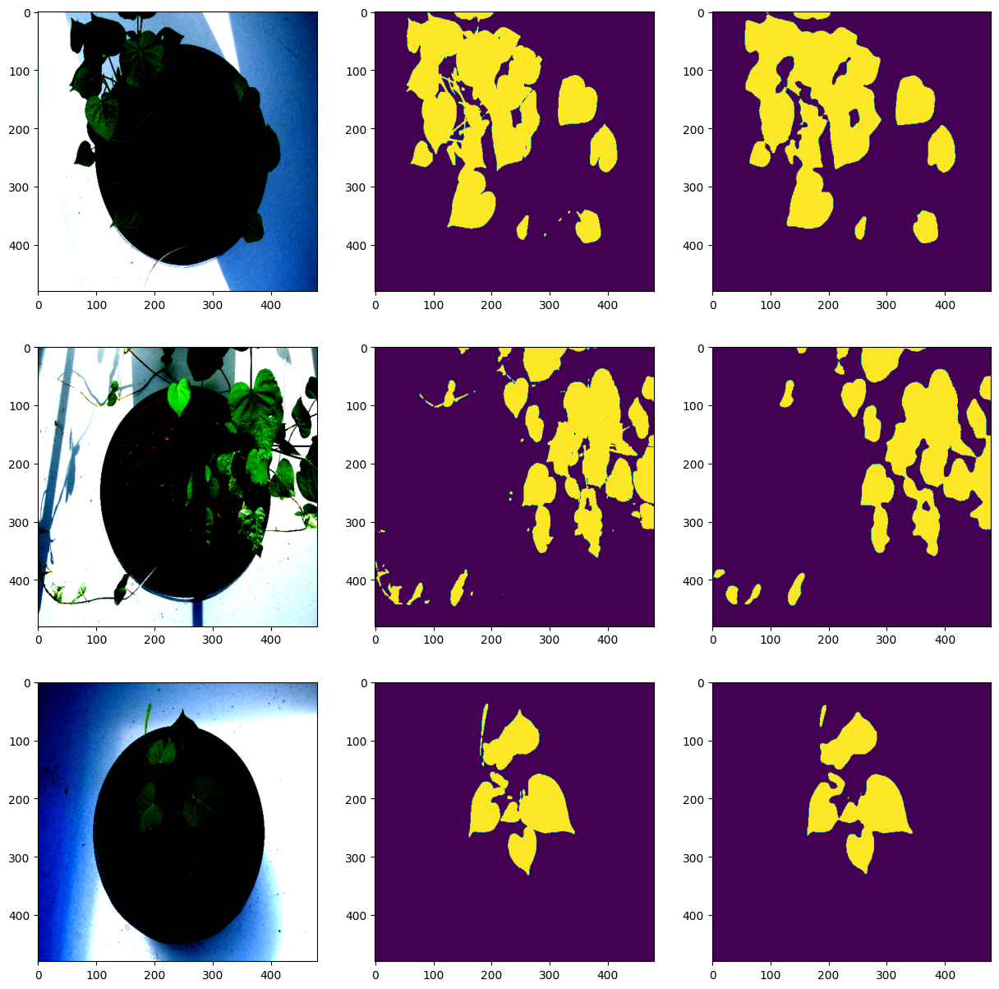

########## Poaceae ############


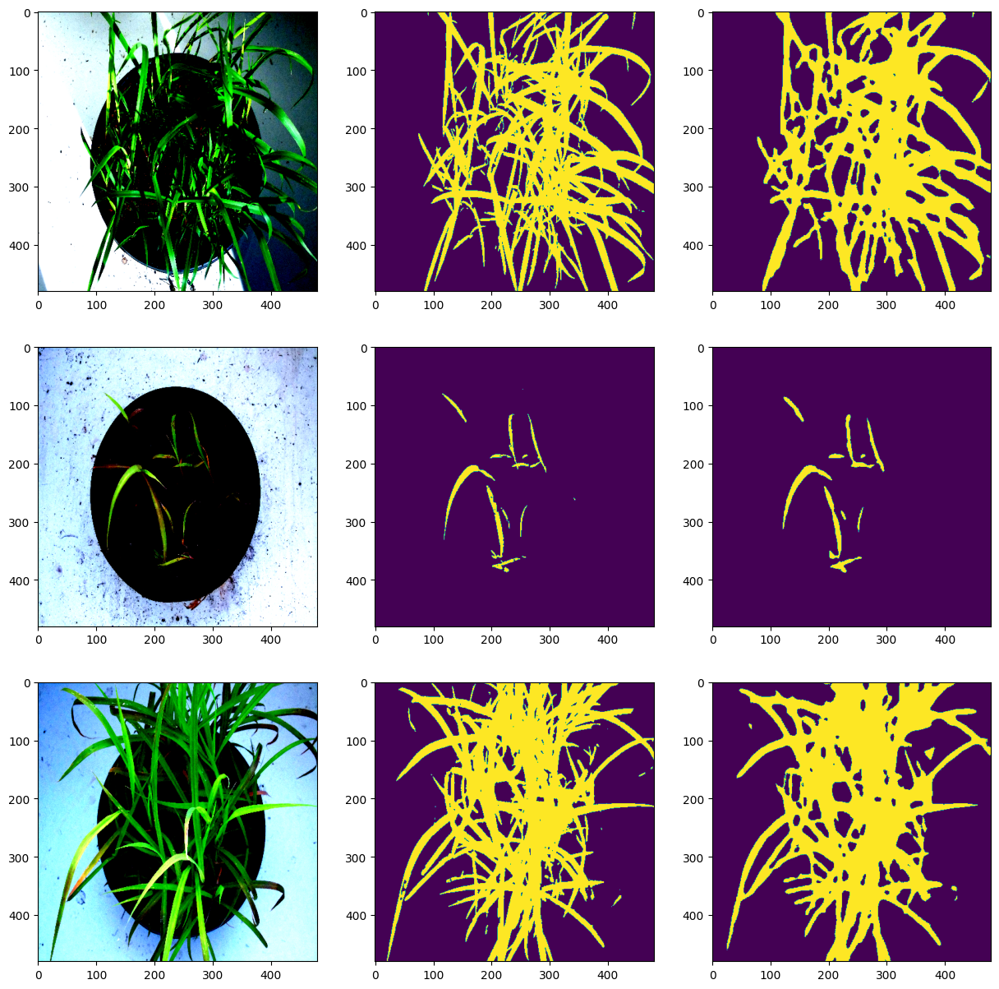

########## Apiaceae ############


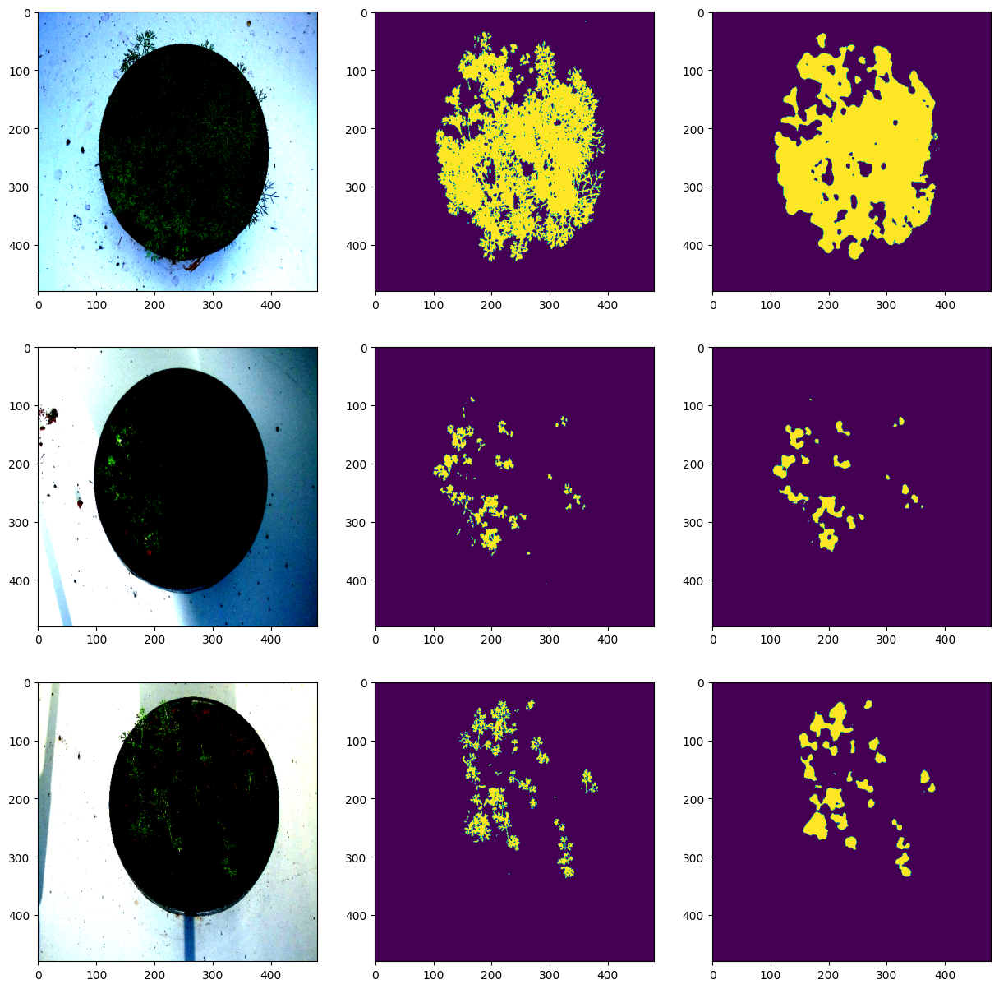

########## Asteraceae ############


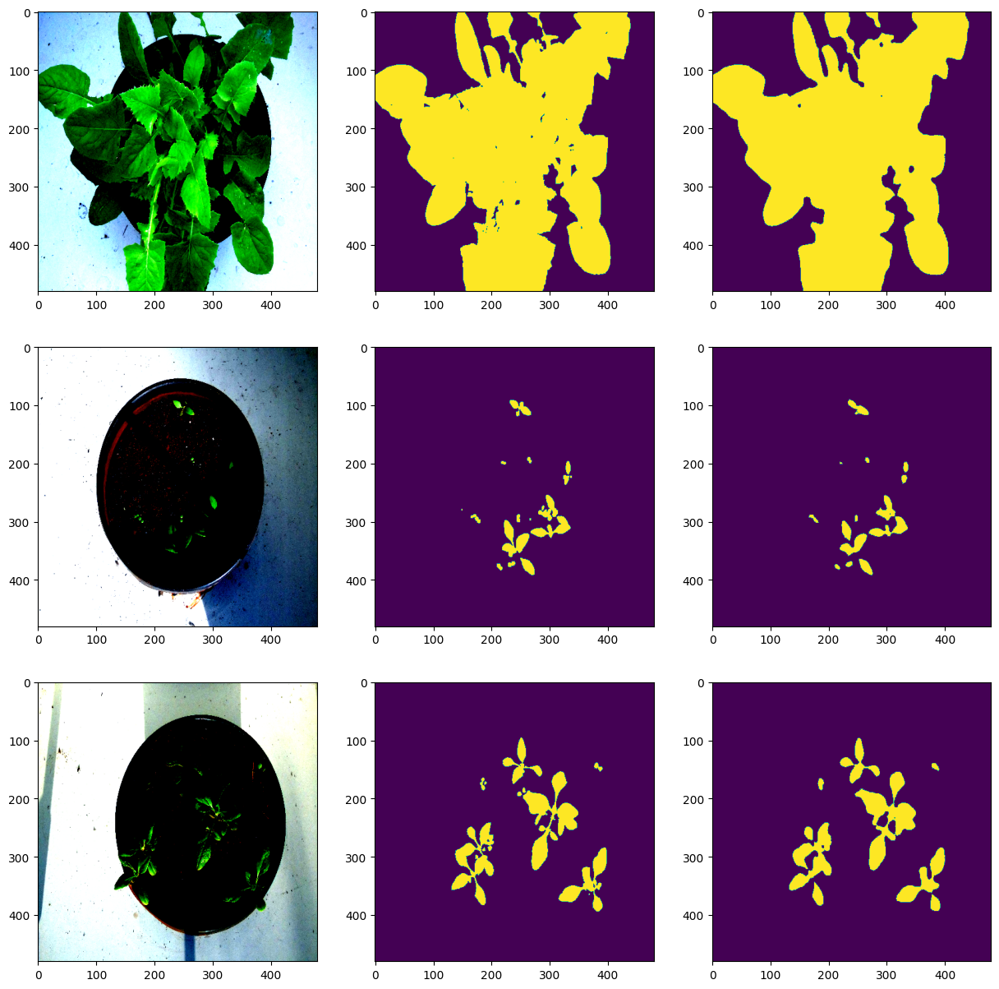

########## Amaranthaceae ############


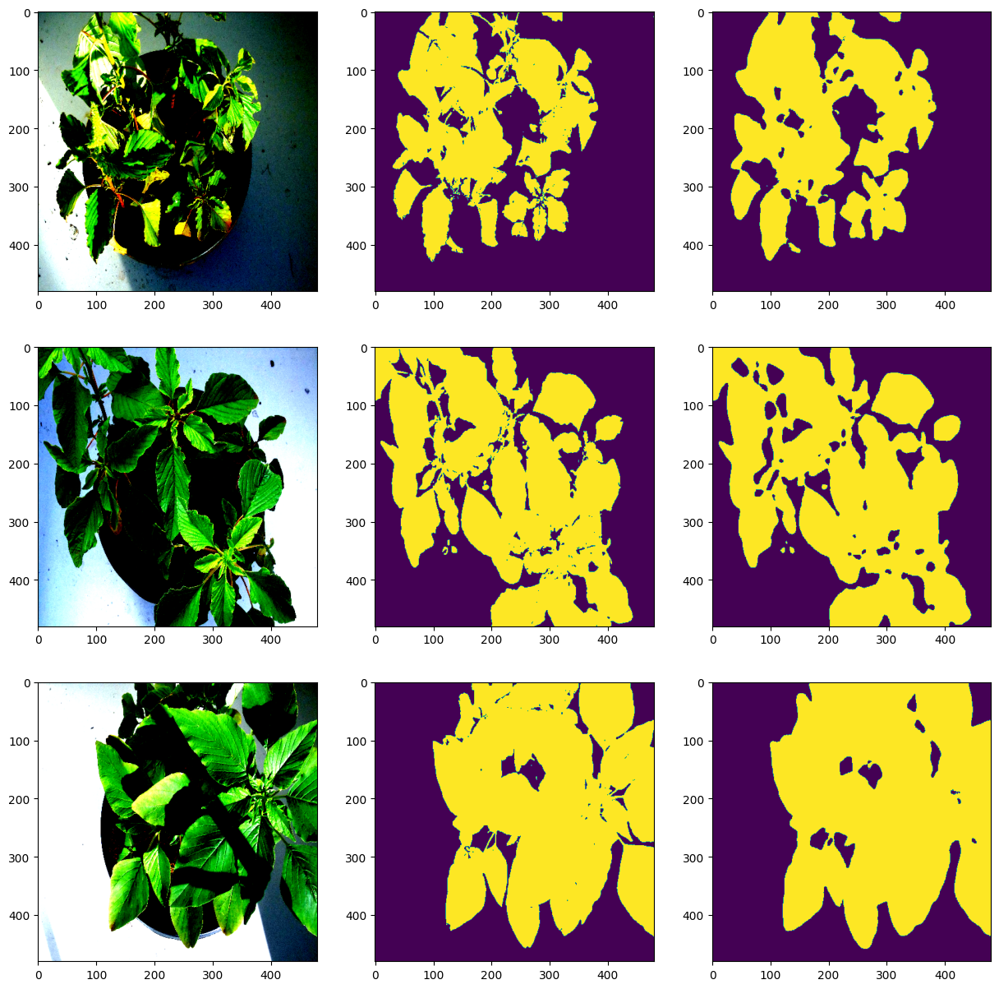

########## Brassicaceae ############


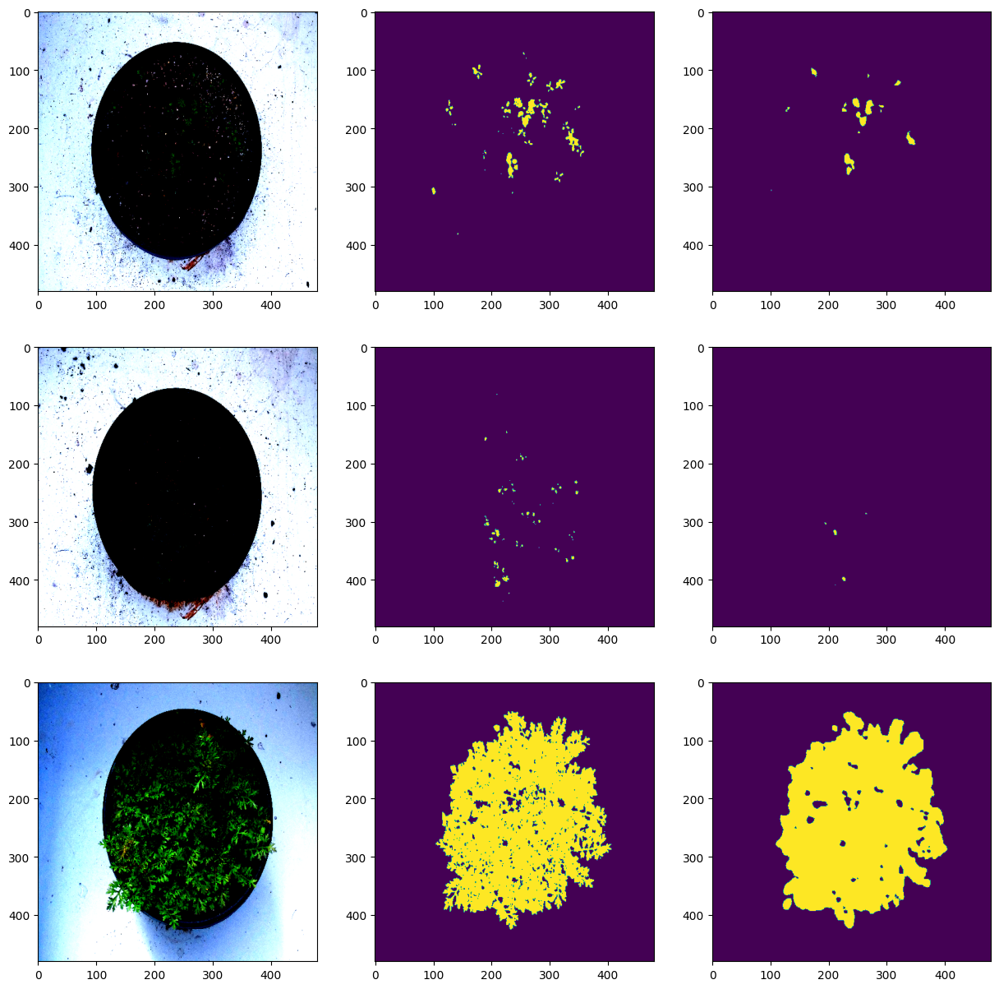

########## Solanaceae ############


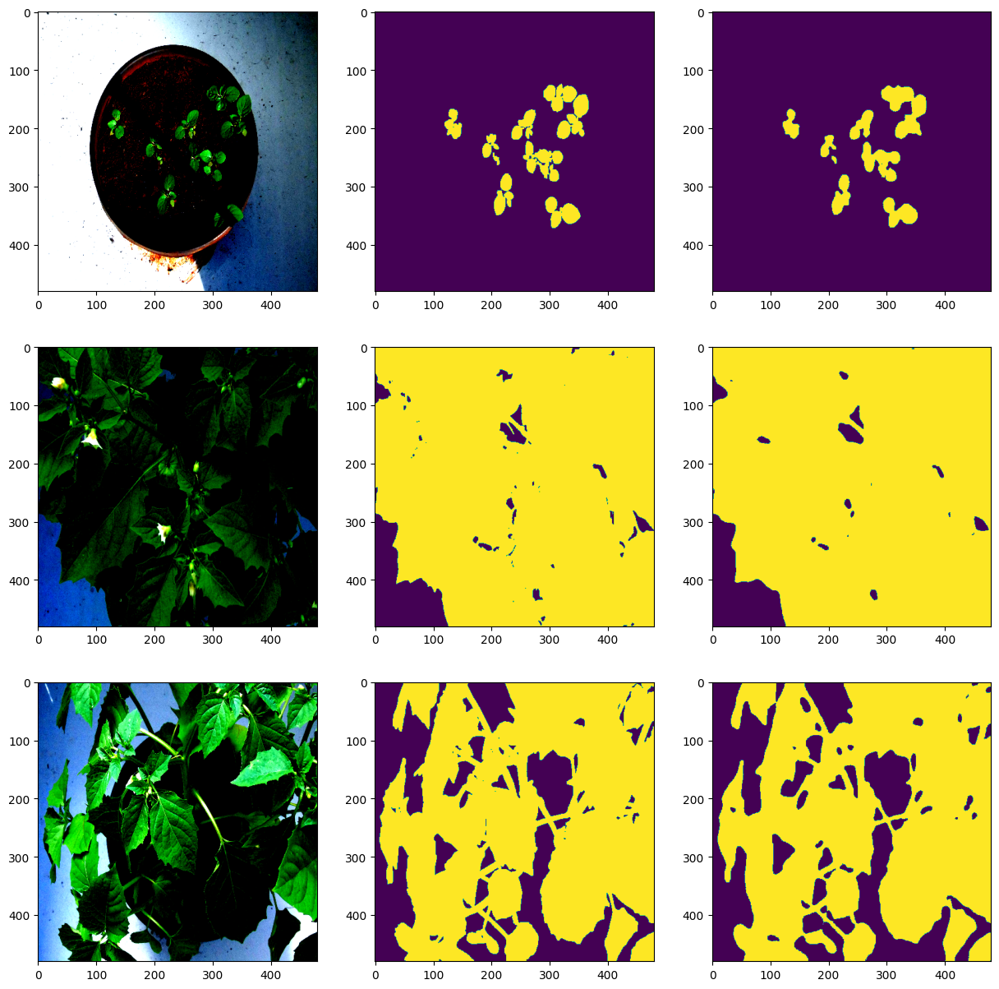

########## Lamiaceae ############


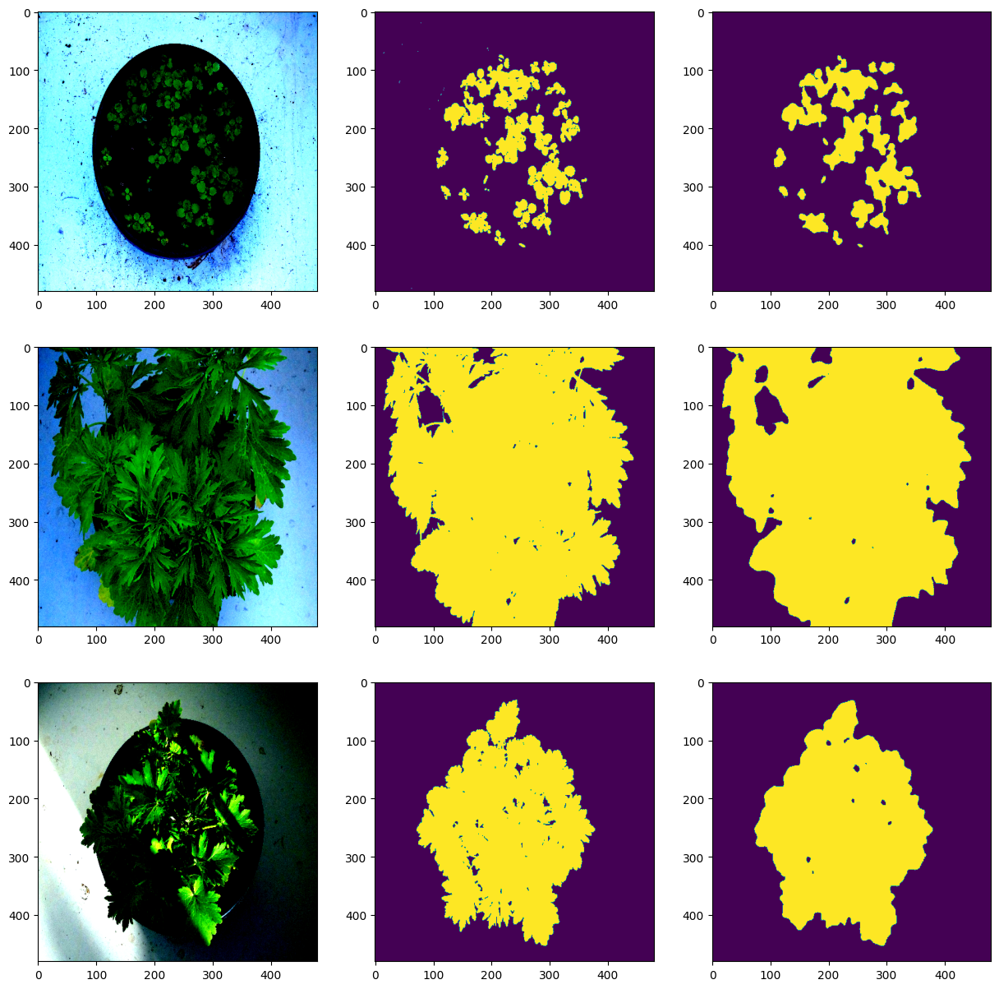

######################################
####### FPN ########
######################################
########## Convolvulaceae ############


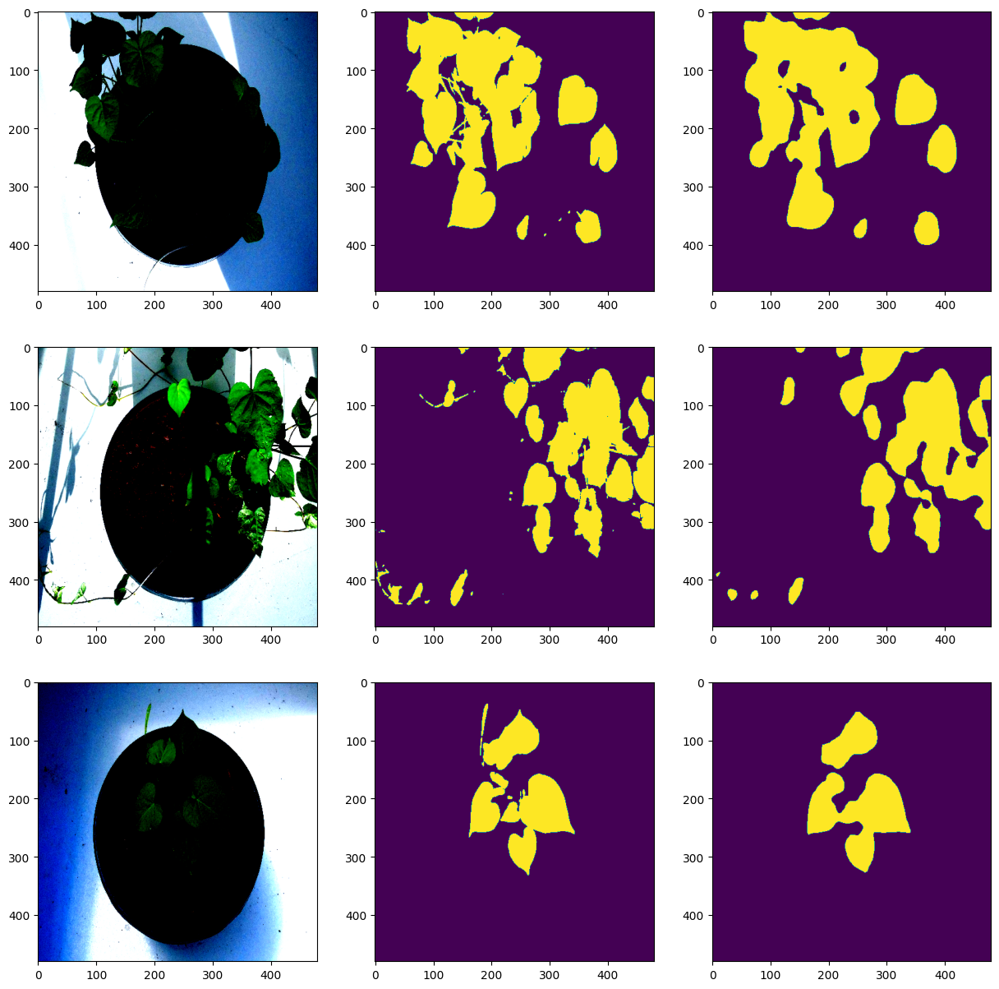

########## Poaceae ############


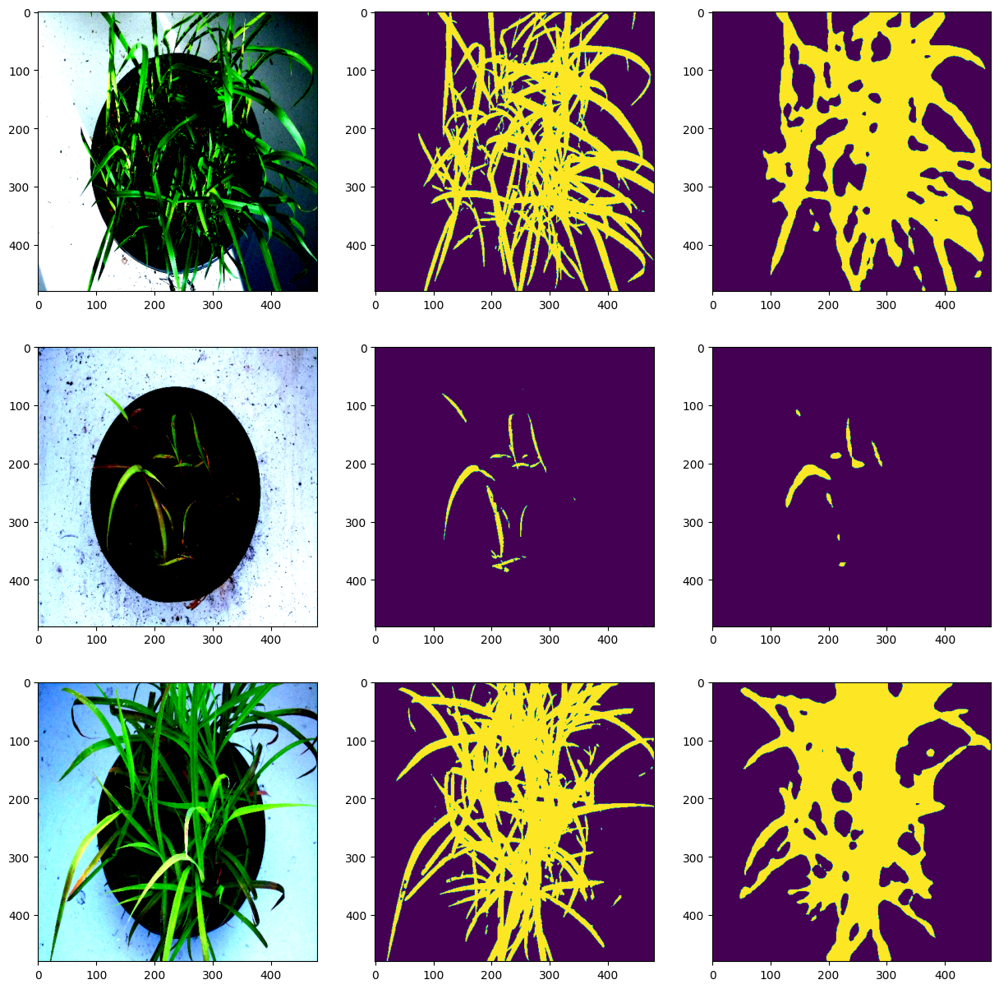

########## Apiaceae ############


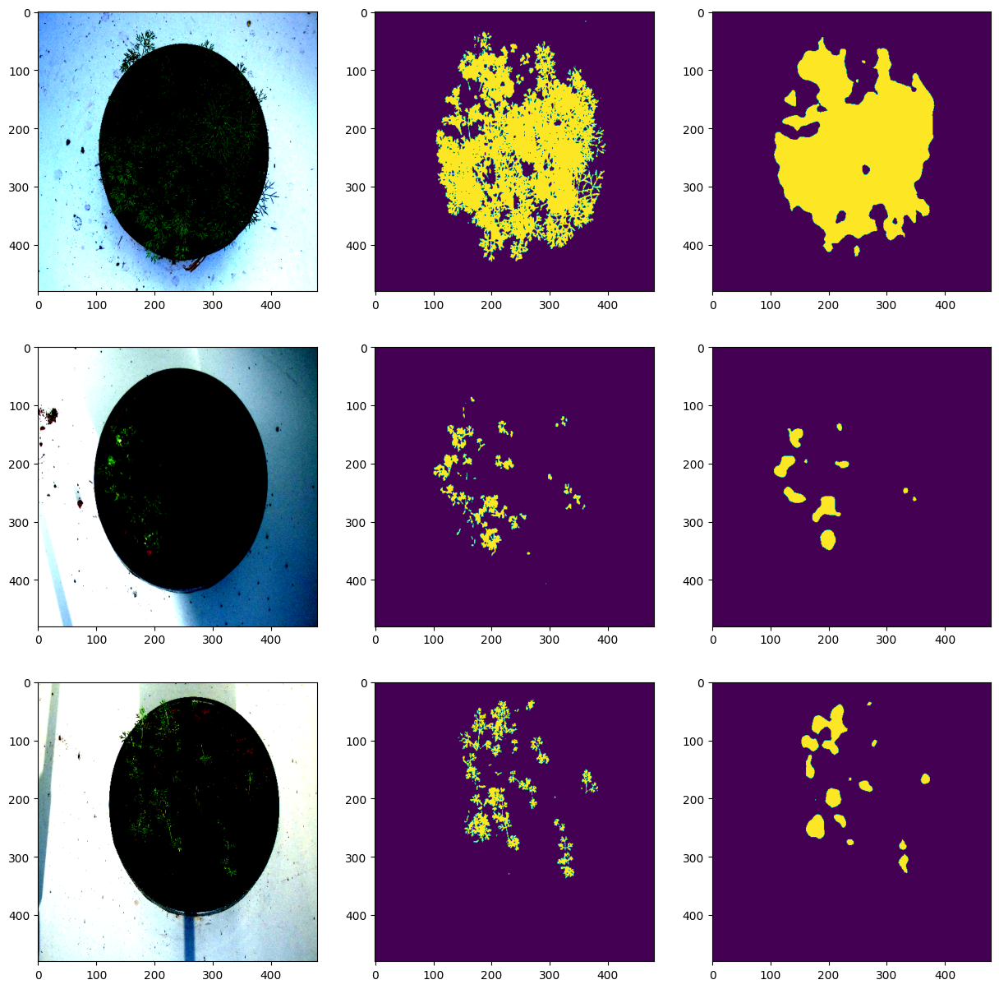

########## Asteraceae ############


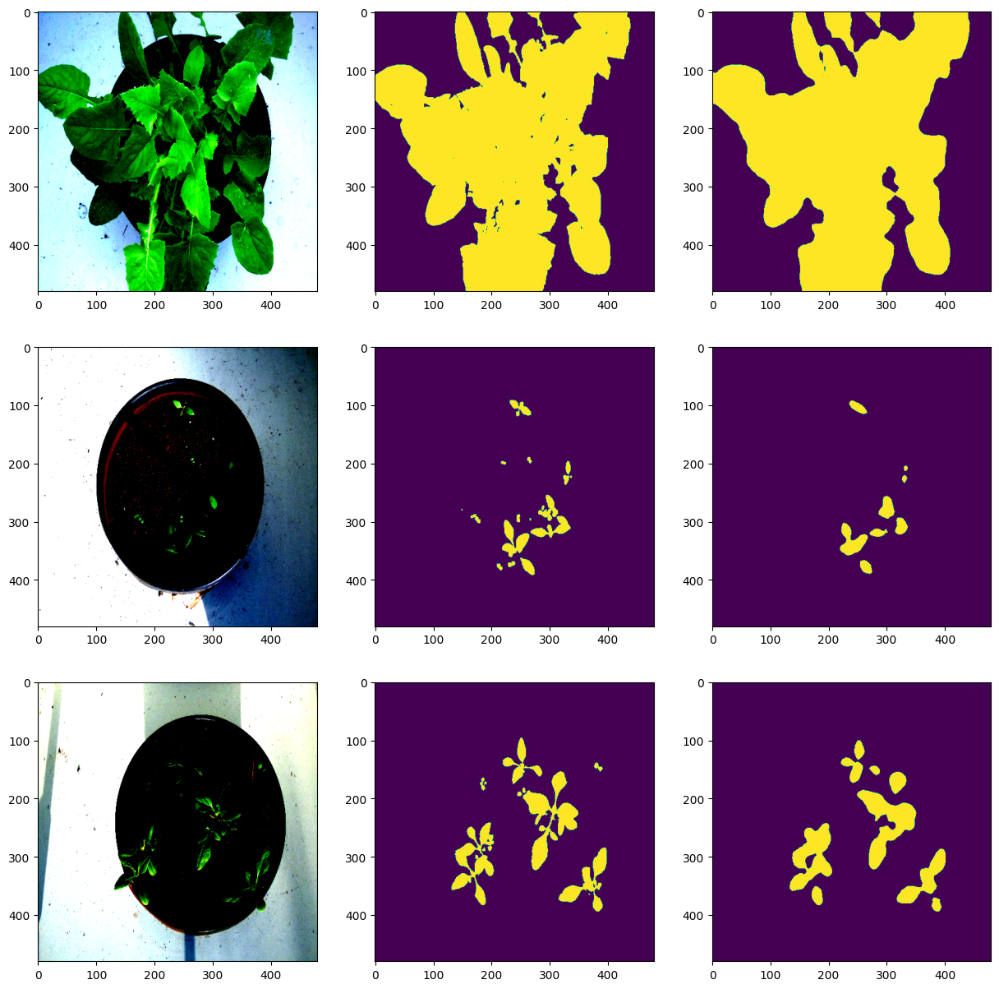

########## Amaranthaceae ############


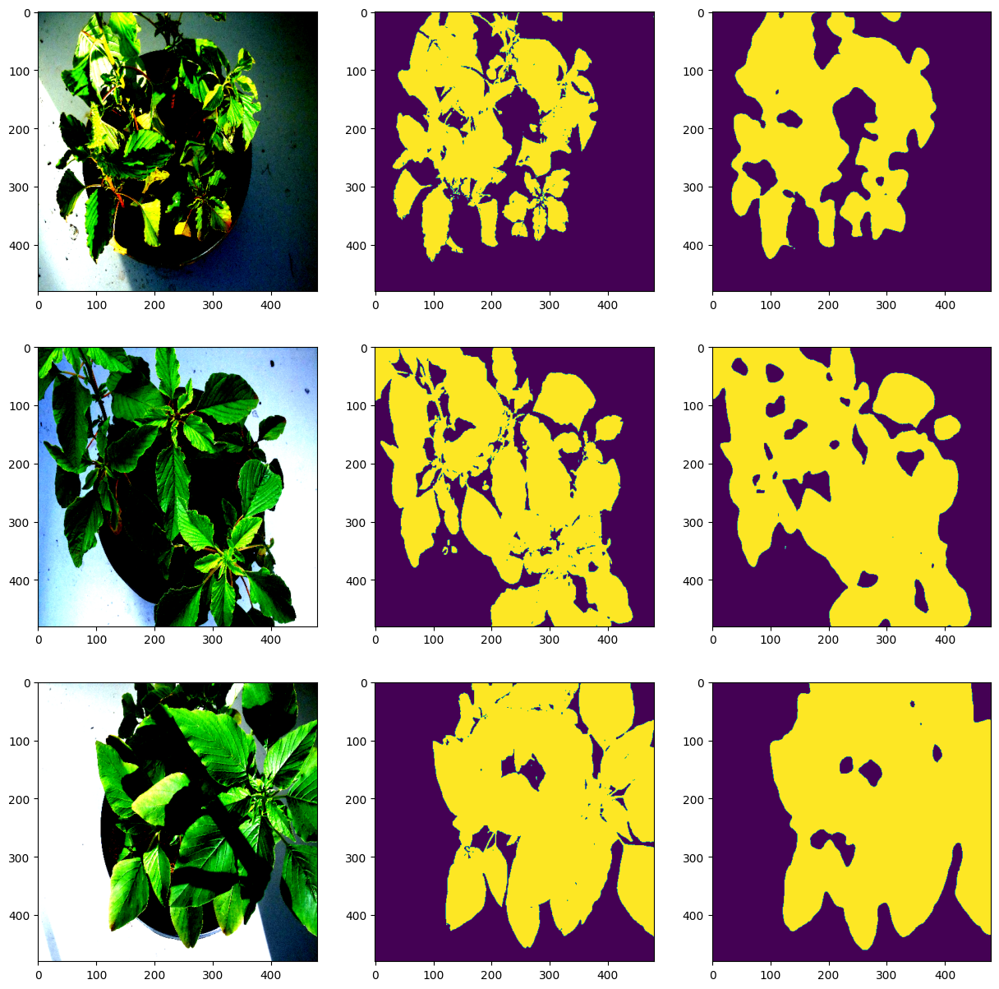

########## Brassicaceae ############


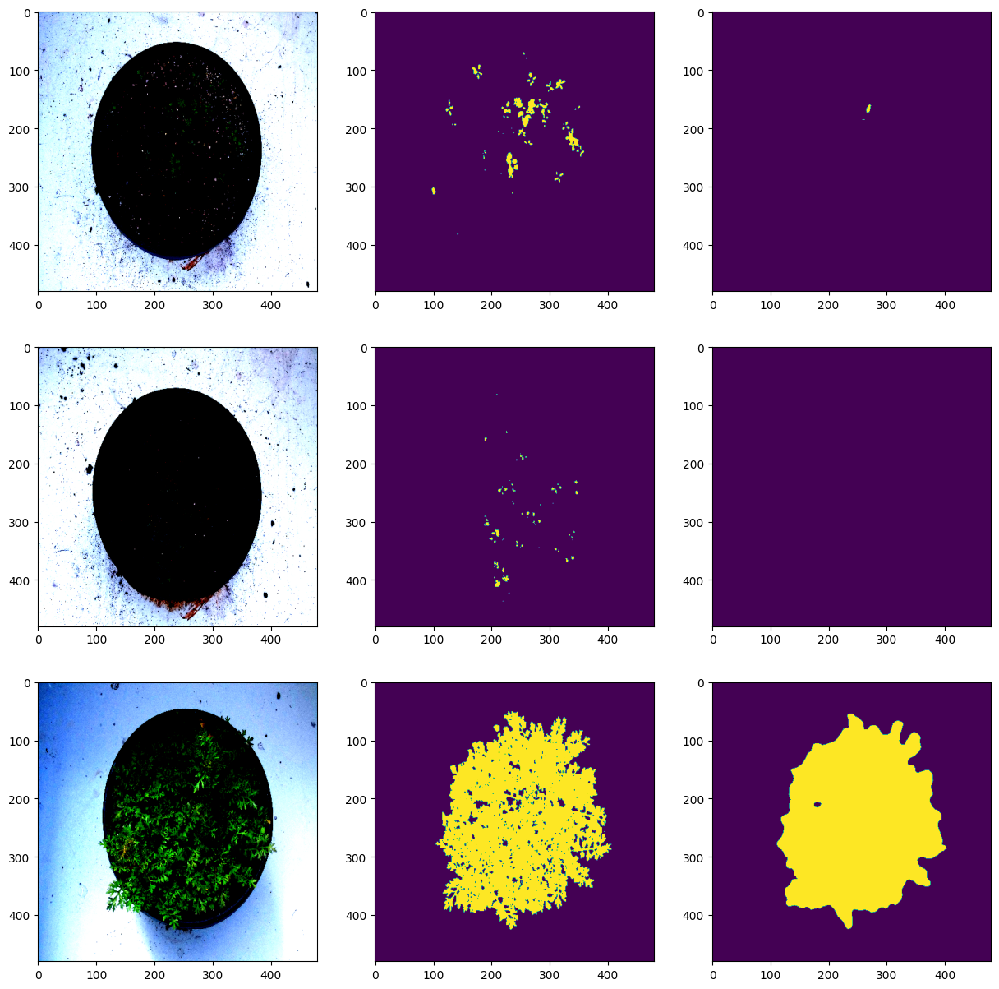

########## Solanaceae ############


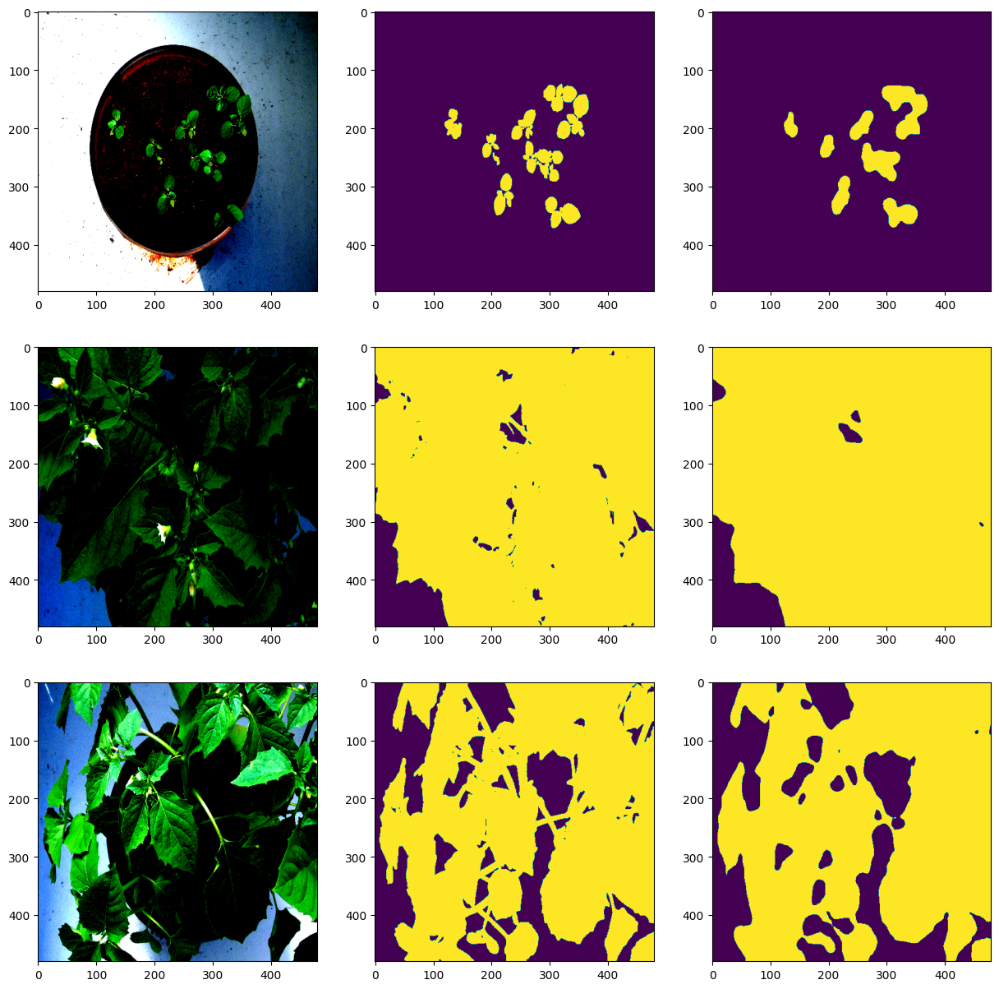

########## Lamiaceae ############


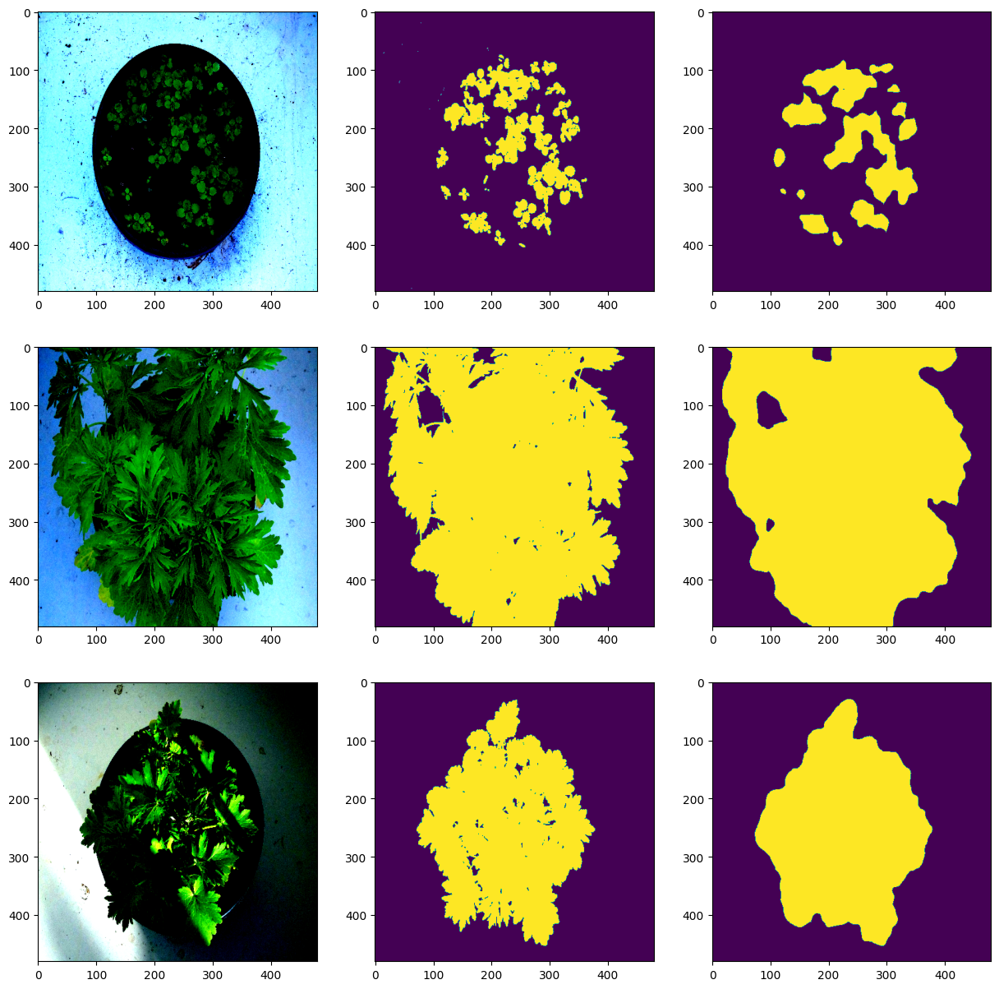

In [141]:
families = ['Convolvulaceae', 'Poaceae', 'Apiaceae', 'Asteraceae', 'Amaranthaceae', 'Brassicaceae', 'Solanaceae', 'Lamiaceae']

for best_model in best_models:
  best_model.eval()
  print('######################################')
  print(f'####### {best_model._get_name()} ########')
  print('######################################')
  for index, test_dataset_vis in enumerate(test_datasets_vis):
    print(f'########## {families[index]} ############')
    _, axs = plt.subplots(3,3,figsize=(15,15))

    for i in range(3): # 3 images for each
      n = i # to comparare between models
      image_vis = test_dataset_vis[n][0].astype('uint8')
      image, gt_mask = test_dataset_vis[n]
      gt_mask = gt_mask.squeeze()

      x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
      pr_mask = best_model.predict(x_tensor)
      pr_mask = (pr_mask.squeeze().cpu().numpy().round())

      axs[i][0].imshow(np.transpose(image, (1,2,0)))
      axs[i][1].imshow(gt_mask)
      axs[i][2].imshow(pr_mask)

    image_dir = 'drive/My Drive/TCC/segmentation_results_visualization/' + best_model._get_name()
    image_path = image_dir + "/" +  best_model._get_name() + "_" + families[index]
    if not os.path.exists(image_dir):
      os.mkdir(image_dir)
    plt.savefig(f'{image_path}.png')
    plt.show()